<a href="https://colab.research.google.com/github/hvkchaitanya7/grp3capstone-final/blob/main/code/basemodel/ImageCaptionGroup3_BaseLine_resnet50_LSTM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Reference (GitHub):- https://github.com/hlamba28/Automatic-Image-Captioning/blob/master/Automatic%20Image%20Captioning.ipynb

In [ ]:
!rm -rf Flickr8k_Dataset.zip
!rm -rf Flickr8k_text.zip
!wget https://github.com/jbrownlee/Datasets/releases/download/Flickr8k/Flickr8k_Dataset.zip -O Flickr8k_Dataset.zip
!wget https://github.com/jbrownlee/Datasets/releases/download/Flickr8k/Flickr8k_text.zip -O Flickr8k_text.zip
!unzip Flickr8k_Dataset.zip
!unzip Flickr8k_text.zip

In [ ]:

import numpy as np
from numpy import array
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import string
import os
from PIL import Image
import glob
from pickle import dump, load
from time import time
from keras.preprocessing import sequence
from keras.models import Sequential
from keras import optimizers
from keras import Input, layers
from keras.applications.inception_v3 import preprocess_input
from keras.layers import LSTM, Embedding, TimeDistributed, Dense, RepeatVector, Activation, Flatten, Reshape, concatenate, Dropout, BatchNormalization
from keras.layers.wrappers import Bidirectional
from keras.layers.merge import add
from keras.applications.inception_v3 import InceptionV3
from keras.preprocessing import image
from keras.models import Model
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.utils import plot_model
from nltk.translate.bleu_score import sentence_bleu
import tensorflow as tf

In [ ]:
# from keras.optimizers import Adam, RMSprop
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.optimizers import Adam, RMSprop

In [ ]:
# load doc into memory
def load_doc(filename):
	# open the file as read only
	file = open(filename, 'r')
	# read all text
	text = file.read()
	# close the file
	file.close()
	return text

filename = "/content/Flickr8k.token.txt"
# load descriptions
doc = load_doc(filename)
print(doc[:300])

1000268201_693b08cb0e.jpg#0	A child in a pink dress is climbing up a set of stairs in an entry way .
1000268201_693b08cb0e.jpg#1	A girl going into a wooden building .
1000268201_693b08cb0e.jpg#2	A little girl climbing into a wooden playhouse .
1000268201_693b08cb0e.jpg#3	A little girl climbing the s


In [ ]:
def load_descriptions(doc):
	mapping = dict()
	# process lines
	for line in doc.split('\n'):
		# split line by white space
		tokens = line.split()
		if len(line) < 2:
			continue
		# take the first token as the image id, the rest as the description
		image_id, image_desc = tokens[0], tokens[1:]
		# extract filename from image id
		image_id = image_id.split('.')[0]
		# convert description tokens back to string
		image_desc = ' '.join(image_desc)
		# create the list if needed
		if image_id not in mapping:
			mapping[image_id] = list()
		# store description
		mapping[image_id].append(image_desc)
	return mapping


In [ ]:
# parse descriptions
descriptions = load_descriptions(doc)
print('Loaded: %d ' % len(descriptions))

Loaded: 8092 


In [ ]:
descriptions

In [ ]:
list(descriptions.keys())[:5]

In [ ]:
descriptions['1000268201_693b08cb0e']

In [ ]:
def clean_descriptions(descriptions):
	# prepare translation table for removing punctuation
	table = str.maketrans('', '', string.punctuation)
	for key, desc_list in descriptions.items():
		for i in range(len(desc_list)):
			desc = desc_list[i]
			# tokenize
			desc = desc.split()
			# convert to lower case
			desc = [word.lower() for word in desc]
			# remove punctuation from each token
			desc = [w.translate(table) for w in desc]
			# remove hanging 's' and 'a'
			desc = [word for word in desc if len(word)>1]
			# remove tokens with numbers in them
			desc = [word for word in desc if word.isalpha()]
			# store as string
			desc_list[i] =  ' '.join(desc)

# clean descriptions
clean_descriptions(descriptions)

In [ ]:
# convert the loaded descriptions into a vocabulary of words
def to_vocabulary(descriptions):
	# build a list of all description strings
	all_desc = set()
	for key in descriptions.keys():
		[all_desc.update(d.split()) for d in descriptions[key]]
	return all_desc

# summarize vocabulary
vocabulary = to_vocabulary(descriptions)
print('Original Vocabulary Size: %d' % len(vocabulary))

Original Vocabulary Size: 8763


In [ ]:
# save descriptions to file, one per line
def save_descriptions(descriptions, filename):
	lines = list()
	for key, desc_list in descriptions.items():
		for desc in desc_list:
			lines.append(key + ' ' + desc)
	data = '\n'.join(lines)
	file = open(filename, 'w')
	file.write(data)
	file.close()

save_descriptions(descriptions, 'descriptions.txt')


In [ ]:
# load a pre-defined list of photo identifiers
def load_set(filename):
	doc = load_doc(filename)
	dataset = list()
	# process line by line
	for line in doc.split('\n'):
		# skip empty lines
		if len(line) < 1:
			continue
		# get the image identifier
		identifier = line.split('.')[0]
		dataset.append(identifier)
	return set(dataset)

# load training dataset (6K)
filename = '/content/Flickr_8k.trainImages.txt'
train = load_set(filename)
print('Dataset: %d' % len(train))

Dataset: 6000


In [ ]:
train

In [ ]:
# Below path contains all the images
images = '/content/Flicker8k_Dataset/'
# Create a list of all image names in the directory
img = glob.glob(images + '*.jpg')

In [ ]:
# Below file conatains the names of images to be used in train data
train_images_file = '/content/Flickr_8k.trainImages.txt'
# Read the train image names in a set
train_images = set(open(train_images_file, 'r').read().strip().split('\n'))

# Create a list of all the training images with their full path names
train_img = []

for i in img: # img is list of full path names of all images
    if i[len(images):] in train_images: # Check if the image belongs to training set
        train_img.append(i) # Add it to the list of train images

In [ ]:
# Below file conatains the names of images to be used in test data
test_images_file = '/content/Flickr_8k.testImages.txt'
# Read the validation image names in a set# Read the test image names in a set
test_images = set(open(test_images_file, 'r').read().strip().split('\n'))

# Create a list of all the test images with their full path names
test_img = []

for i in img: # img is list of full path names of all images
    if i[len(images):] in test_images: # Check if the image belongs to test set
        test_img.append(i) # Add it to the list of test images

In [ ]:
# load clean descriptions into memory
def load_clean_descriptions(filename, dataset):
	# load document
	doc = load_doc(filename)
	descriptions = dict()
	for line in doc.split('\n'):
		# split line by white space
		tokens = line.split()
		# split id from description
		image_id, image_desc = tokens[0], tokens[1:]
		# skip images not in the set
		if image_id in dataset:
			# create list
			if image_id not in descriptions:
				descriptions[image_id] = list()
			# wrap description in tokens
			desc = 'startseq ' + ' '.join(image_desc) + ' endseq'
			# store
			descriptions[image_id].append(desc)
	return descriptions

# descriptions
train_descriptions = load_clean_descriptions('descriptions.txt', train)
print('Descriptions: train=%d' % len(train_descriptions))

Descriptions: train=6000


In [ ]:
def preprocess(image_path):
    # Convert all the images to size 224X224 as expected by the inception v3 model
    img = image.load_img(image_path, target_size=(224, 224,3))
    # Convert PIL image to numpy array of 3-dimensions
    x = image.img_to_array(img)
    #print(x.shape())
    # Add one more dimension
    x = np.expand_dims(x, axis=0)
    # preprocess the images using preprocess_input() from inception module
    #x = preprocess_input(x)
    return x

In [ ]:
# Load the ResNet v3 model
model = ResNet50(include_top=True,weights='imagenet',input_shape=(224, 224,3),pooling="avg")

102981632/102967424 [==============================] - 1s 0us/step


In [ ]:
model.summary()

Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                           

In [ ]:
# Create a new model, by removing the last layer (output layer) from the inception v3
model_new = Model(model.input, model.layers[-2].output)

In [ ]:
model_new.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                              

In [ ]:
# Function to encode a given image into a vector of size (2048, )
def encode(image):
    image = preprocess(image) # preprocess the image
    fea_vec = model_new.predict(image) # Get the encoding vector for the image
    fea_vec = np.reshape(fea_vec, fea_vec.shape[1]) # reshape from (1, 2048) to (2048, )
    return fea_vec

In [ ]:
# Call the funtion to encode all the train images
# This will take a while on CPU - Execute this only once
start = time()
encoding_train = {}
for img in train_img:
    encoding_train[img[len(images):]] = encode(img)
print("Time taken in seconds =", time()-start)

Time taken in seconds = 408.8538362979889


In [ ]:
pkl_train_file="/content/Pickle_ResNet/encoded_train_images.pkl"

In [ ]:
# Save the bottleneck train features to disk
with open(pkl_train_file, "wb") as encoded_pickle:
    dump(encoding_train, encoded_pickle)

    # /content/sample_data/Pickle/encoded_train_images.pkl

In [ ]:
# Call the funtion to encode all the test images - Execute this only once
start = time()
encoding_test = {}
for img in test_img:
    encoding_test[img[len(images):]] = encode(img)
print("Time taken in seconds =", time()-start)

Time taken in seconds = 66.38999223709106


In [ ]:
pkl_test_file = "/content/Pickle_ResNet/encoded_test_images.pkl"

In [ ]:

# Save the bottleneck test features to disk
with open(pkl_test_file, "wb") as encoded_pickle:
    dump(encoding_test, encoded_pickle)

In [ ]:
train_features = load(open(pkl_train_file, "rb"))
print('Photos: train=%d' % len(train_features))

Photos: train=6000


In [ ]:
# Create a list of all the training captions
all_train_captions = []
for key, val in train_descriptions.items():
    for cap in val:
        all_train_captions.append(cap)
len(all_train_captions)

30000

In [ ]:
# Consider only words which occur at least 10 times in the corpus
word_count_threshold = 10
word_counts = {}
nsents = 0
for sent in all_train_captions:
    nsents += 1
    for w in sent.split(' '):
        word_counts[w] = word_counts.get(w, 0) + 1

vocab = [w for w in word_counts if word_counts[w] >= word_count_threshold]
print('preprocessed words %d -> %d' % (len(word_counts), len(vocab)))

preprocessed words 7578 -> 1651


In [ ]:
ixtoword = {}
wordtoix = {}

ix = 1
for w in vocab:
    wordtoix[w] = ix
    ixtoword[ix] = w
    ix += 1

In [ ]:
vocab_size = len(ixtoword) + 1 # one for appended 0's
vocab_size

1652

In [ ]:
# convert a dictionary of clean descriptions to a list of descriptions
def to_lines(descriptions):
	all_desc = list()
	for key in descriptions.keys():
		[all_desc.append(d) for d in descriptions[key]]
	return all_desc

# calculate the length of the description with the most words
def max_length(descriptions):
	lines = to_lines(descriptions)
	return max(len(d.split()) for d in lines)

# determine the maximum sequence length
max_length = max_length(train_descriptions)
print('Description Length: %d' % max_length)

Description Length: 34


In [ ]:
# data generator, intended to be used in a call to model.fit_generator()
def data_generator(descriptions, photos, wordtoix, max_length, num_photos_per_batch):
    X1, X2, y = list(), list(), list()
    n=0
    # loop for ever over images
    while 1:
        for key, desc_list in descriptions.items():
            n+=1
            # retrieve the photo feature
            photo = photos[key+'.jpg']
            for desc in desc_list:
                # encode the sequence
                seq = [wordtoix[word] for word in desc.split(' ') if word in wordtoix]
                # split one sequence into multiple X, y pairs
                for i in range(1, len(seq)):
                    # split into input and output pair
                    in_seq, out_seq = seq[:i], seq[i]
                    # pad input sequence
                    in_seq = pad_sequences([in_seq], maxlen=max_length)[0]
                    # encode output sequence
                    out_seq = to_categorical([out_seq], num_classes=vocab_size)[0]
                    # store
                    X1.append(photo)
                    X2.append(in_seq)
                    y.append(out_seq)
            # yield the batch data
            if n==num_photos_per_batch:
                yield [[array(X1), array(X2)], array(y)]
                X1, X2, y = list(), list(), list()
                n=0

In [ ]:
!wget http://nlp.stanford.edu/data/glove.6B.zip

--2022-07-16 05:22:10--  http://nlp.stanford.edu/data/glove.6B.zip
Resolving nlp.stanford.edu (nlp.stanford.edu)... 171.64.67.140
Connecting to nlp.stanford.edu (nlp.stanford.edu)|171.64.67.140|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://nlp.stanford.edu/data/glove.6B.zip [following]
--2022-07-16 05:22:10--  https://nlp.stanford.edu/data/glove.6B.zip
Connecting to nlp.stanford.edu (nlp.stanford.edu)|171.64.67.140|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://downloads.cs.stanford.edu/nlp/data/glove.6B.zip [following]
--2022-07-16 05:22:10--  https://downloads.cs.stanford.edu/nlp/data/glove.6B.zip
Resolving downloads.cs.stanford.edu (downloads.cs.stanford.edu)... 171.64.64.22
Connecting to downloads.cs.stanford.edu (downloads.cs.stanford.edu)|171.64.64.22|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 862182613 (822M) [application/zip]
Saving to: ‘glove.6B.zip’

glov

In [ ]:
!unzip glove*.zip

Archive:  glove.6B.zip
  inflating: glove.6B.50d.txt        
  inflating: glove.6B.100d.txt       
  inflating: glove.6B.200d.txt       
  inflating: glove.6B.300d.txt       


In [ ]:
!wget http://nlp.stanford.edu/data/glove.6B.200d.zip

--2022-07-16 05:25:47--  http://nlp.stanford.edu/data/glove.6B.200d.zip
Resolving nlp.stanford.edu (nlp.stanford.edu)... 171.64.67.140
Connecting to nlp.stanford.edu (nlp.stanford.edu)|171.64.67.140|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://nlp.stanford.edu/data/glove.6B.200d.zip [following]
--2022-07-16 05:25:47--  https://nlp.stanford.edu/data/glove.6B.200d.zip
Connecting to nlp.stanford.edu (nlp.stanford.edu)|171.64.67.140|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://downloads.cs.stanford.edu/nlp/data/glove.6B.200d.zip [following]
--2022-07-16 05:25:47--  https://downloads.cs.stanford.edu/nlp/data/glove.6B.200d.zip
Resolving downloads.cs.stanford.edu (downloads.cs.stanford.edu)... 171.64.64.22
Connecting to downloads.cs.stanford.edu (downloads.cs.stanford.edu)|171.64.64.22|:443... connected.
HTTP request sent, awaiting response... 404 Not Found
2022-07-16 05:25:47 ERROR 404: Not Found.


In [ ]:

# Load Glove vectors
glove_dir = '/content/'
embeddings_index = {} # empty dictionary
f = open(os.path.join(glove_dir, 'glove.6B.200d.txt'), encoding="utf-8")

for line in f:
    values = line.split()
    word = values[0]
    coefs = np.asarray(values[1:], dtype='float32')
    embeddings_index[word] = coefs
f.close()
print('Found %s word vectors.' % len(embeddings_index))

Found 400000 word vectors.


In [ ]:
vocab_size

1652

In [ ]:
embedding_dim = 200

# Get 200-dim dense vector for each of the 10000 words in out vocabulary
embedding_matrix = np.zeros((vocab_size, embedding_dim))

for word, i in wordtoix.items():
    #if i < max_words:
    embedding_vector = embeddings_index.get(word)
    if embedding_vector is not None:
        # Words not found in the embedding index will be all zeros
        embedding_matrix[i] = embedding_vector

In [ ]:
embedding_matrix.shape

(1652, 200)

In [ ]:
embedding_matrix[1650,0:50]

array([ 0.20298   , -0.10048   , -0.33627   , -0.72679001,  0.23146001,
        0.22077   ,  0.42952001, -0.60758001,  0.85202003, -0.85326999,
       -0.88313001, -0.39104   ,  0.28290999, -0.23973   ,  0.35580999,
       -0.22188   , -0.44758001,  0.33155999, -0.14907999,  0.26605999,
        0.37055001,  0.076139  , -0.31450999, -0.68892002,  0.92940003,
        0.59457999,  0.32692   , -0.14501999, -0.13399   , -0.26473999,
        0.43072   , -0.06878   , -0.66360998, -0.37437001, -0.63537002,
        0.95183003, -0.48716   , -0.24009   ,  0.21712001,  0.78609002,
        0.52569002, -0.56200999,  0.20886999, -0.35106999, -0.35617   ,
       -0.52287   , -0.66702998,  0.59358001, -0.19891   ,  0.60021001])

In [ ]:
max_length

34

In [ ]:
inputs1 = Input(shape=(2048,))
fe1 = Dropout(0.5)(inputs1)
fe2 = Dense(256, activation='relu')(fe1)
inputs2 = Input(shape=(max_length,))
se1 = Embedding(vocab_size, embedding_dim, mask_zero=True)(inputs2)
se2 = Dropout(0.5)(se1)
se3 = LSTM(256)(se2)
decoder1 = add([fe2, se3])
print(decoder1.shape)
decoder2 = Dense(256, activation='relu')(decoder1)
print(decoder2.shape)
outputs = Dense(vocab_size, activation='softmax')(decoder2)
model = Model(inputs=[inputs1, inputs2], outputs=outputs)

(None, 256)
(None, 256)


In [ ]:
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, 34)]         0           []                               
                                                                                                  
 input_4 (InputLayer)           [(None, 2048)]       0           []                               
                                                                                                  
 embedding_1 (Embedding)        (None, 34, 200)      330400      ['input_5[0][0]']                
                                                                                                  
 dropout_2 (Dropout)            (None, 2048)         0           ['input_4[0][0]']                
                                                                                            

In [ ]:
inputs1 = Input(shape=(2048,))
fe1 = Dropout(0.5)(inputs1)
fe2 = Dense(256, activation='relu')(fe1)
inputs2 = Input(shape=(max_length,))
se1 = Embedding(vocab_size, embedding_dim, mask_zero=True)(inputs2)
se2 = Dropout(0.5)(se1)
print('se2 shape', se2.shape)
se3 = LSTM(256,return_sequences =True)(se2)
decoder1 = add([fe2, se3])
print('decoder1 shape',decoder1.shape)
decoder2 = LSTM(256)(decoder1)
decoder3 = Dense(256, activation='relu')(decoder2)
print(decoder2.shape)
outputs = Dense(vocab_size, activation='softmax')(decoder3)
model = Model(inputs=[inputs1, inputs2], outputs=outputs)

se2 shape (None, 34, 200)
decoder1 shape (None, 34, 256)
(None, 256)


In [ ]:
model.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_15 (InputLayer)          [(None, 34)]         0           []                               
                                                                                                  
 input_14 (InputLayer)          [(None, 2048)]       0           []                               
                                                                                                  
 embedding_6 (Embedding)        (None, 34, 200)      330400      ['input_15[0][0]']               
                                                                                                  
 dropout_12 (Dropout)           (None, 2048)         0           ['input_14[0][0]']               
                                                                                            

In [ ]:
model.layers[2].set_weights([embedding_matrix])
model.layers[2].trainable = False

In [ ]:
model.compile(loss='categorical_crossentropy', optimizer='adam')

In [ ]:
epochs = 15
number_pics_per_bath = 20
steps = len(train_descriptions)//number_pics_per_bath

In [ ]:
for i in range(epochs):
    generator = data_generator(train_descriptions, train_features, wordtoix, max_length, number_pics_per_bath)
    model.fit_generator(generator, epochs=1, steps_per_epoch=steps, verbose=1)
    model.save('./model_weights/model_' + str(i) + '.h5')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  This is separate from the ipykernel package so we can avoid doing imports until


300/300 [==============================] - 99s 328ms/step - loss: 2.9907


In [ ]:
for i in range(epochs):
    generator = data_generator(train_descriptions, train_features, wordtoix, max_length, number_pics_per_bath)
    model.fit_generator(generator, epochs=1, steps_per_epoch=steps, verbose=1)
    model.save('./model_weights/model_' + str(i) + '.h5')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  This is separate from the ipykernel package so we can avoid doing imports until


300/300 [==============================] - 98s 327ms/step - loss: 2.8792


In [ ]:
model.optimizer.lr = 0.0001
epochs = 30
number_pics_per_bath = 20
steps = len(train_descriptions)//number_pics_per_bath

In [ ]:
for i in range(epochs):
    generator = data_generator(train_descriptions, train_features, wordtoix, max_length, number_pics_per_bath)
    model.fit_generator(generator, epochs=1, steps_per_epoch=steps, verbose=1)
    #model.save('./model_weights/model_' + str(i) + '.h5')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  This is separate from the ipykernel package so we can avoid doing imports until


300/300 [==============================] - 98s 325ms/step - loss: 2.6974


In [ ]:
model.save_weights('./model_weights/Resnet_model_LSTM_30.h5')

In [ ]:
model.load_weights('./model_weights/Resnet_model_LSTM_30.h5')

In [ ]:
images = '/content/Flicker8k_Dataset/'

In [ ]:
with open(pkl_test_file, "rb") as encoded_pickle:
    encoding_test = load(encoded_pickle)

In [ ]:
def greedySearch(photo):
    in_text = 'startseq'
    for i in range(max_length):
        sequence = [wordtoix[w] for w in in_text.split() if w in wordtoix]
        sequence = pad_sequences([sequence], maxlen=max_length)
        yhat = model.predict([photo,sequence], verbose=0)
        yhat = np.argmax(yhat)
        word = ixtoword[yhat]
        in_text += ' ' + word
        if word == 'endseq':
            break
    final = in_text.split()
    final = final[1:-1]
    final = ' '.join(final)
    return final

In [ ]:
from nltk.translate.bleu_score import sentence_bleu
import tensorflow as tf
def get_bleuscore(pred_desc, image_name):
    cand_desc = pred_desc.split()
    #print("blue score desc", cand_desc)
    img_name = image_name.split(".jpg")[0]
    refer_desc = descriptions[img_name]
    refer_list = []
    for s in refer_desc:
         s = s.split()
         refer_list.append(s)
    #print(s)
    print("Expert Caption:",refer_desc)
    #print (refer_list)
    score = sentence_bleu(refer_list,cand_desc,weights=(0, 0, 1))
    #print(score)
    return(score)

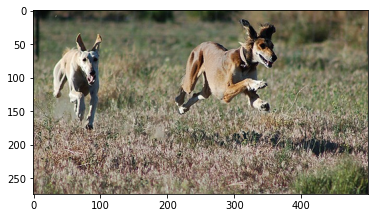

Expert Caption: ['tan dog and cream colored dog run through grasslands', 'white dog and brown dog running across grassy field', 'two dogs bound across the grass', 'two skinny dogs are running towards camera across grassy field', 'two thin dogs are running fast through tall dry grass']
Blue score 0.1470828170974326
caption: two dogs are running through field of grass


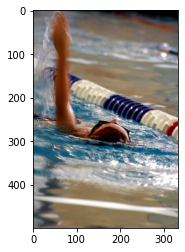

Expert Caption: ['person doing the backstroke in swimming pool', 'person swimming in swimming pool', 'swimmer is doing the backstroke in the swimming pool', 'swimmer does backstroke in swimming lane', 'the arm of swimmer rises from the water inside the striped lane marker']
Blue score 2.2250738585072626e-308
caption: young boy is splashing in the water


/usr/local/lib/python3.7/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


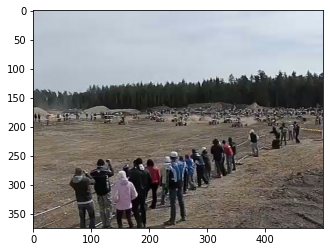

Expert Caption: ['crowd watching dirt bike race', 'group of people on the sidelines of an atv race', 'line of people staring at the vehicles on the dirt track', 'line of spectators at race', 'people standing at fence watching motor vehicles in field']
Blue score 0.2
caption: group of people are walking on beach


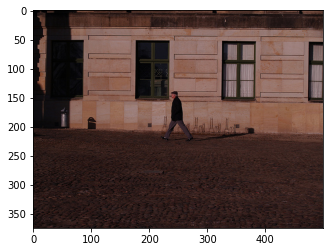

Expert Caption: ['man wearing black hat walks along road next to building', 'an older man in long sleeved black shirt is walking down cobblestone street alone', 'old man walks down the uncrowded road', 'person walking in front of building', 'the man is walking near brown building']
Blue score 2.2250738585072626e-308
caption: man and woman walk down the street


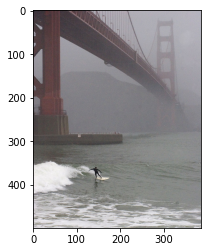

Expert Caption: ['man surfs by the golden gate bridge on foggy day', 'surfer rides wave under red bridge', 'surfer by bridge in foggy conditions', 'surfer under bridge', 'man surfing under the golden gate bridge on foggy day']
Blue score 2.2250738585072626e-308
caption: person in the water


/usr/local/lib/python3.7/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


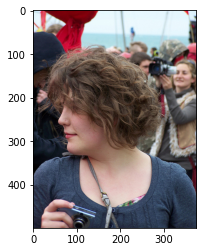

Expert Caption: ['lady looks to her right and holds mini camera', 'lady with curly brown hair stands in crowd with camera', 'woman holding camera', 'woman stands in crowd holding camera', 'the woman with camera is looking to the side in crowded area']
Blue score 2.2250738585072626e-308
caption: woman with glasses is holding baby in his mouth


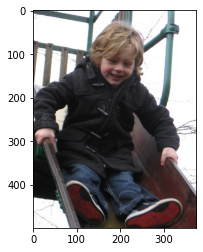

Expert Caption: ['child is happily playing on the slide', 'child is holding on to the top of playground slide', 'child is preparing to slide down piece of playground equipment', 'toddler all bundled up getting ready to go down slide', 'child getting ready to go down slide']
Blue score 2.2250738585072626e-308
caption: little boy is sitting on the bed with his arms out


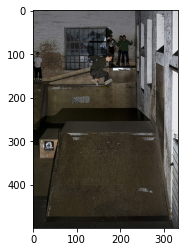

Expert Caption: ['lone skateboarder jumping huge skateboarding ramp', 'man dressed all in black performs trick on rail while wearing inline skates', 'an inline skater doing jump on ramp', 'skateboarder makes jump off ramp', 'the skateboarder is jumping over ramp']
Blue score 2.2250738585072626e-308
caption: skateboarder is doing trick on ramp


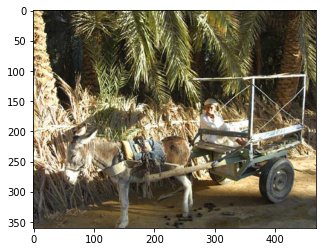

Expert Caption: ['donkey pulling cart with boy in it takes brake', 'donkey pulling car with man on it', 'mule is carring man in cart next to some palm trees', 'mule pulling carriage with man inside along dirt path', 'person is pulled in cart by donkey']
Blue score 2.2250738585072626e-308
caption: group of people riding bike in the woods


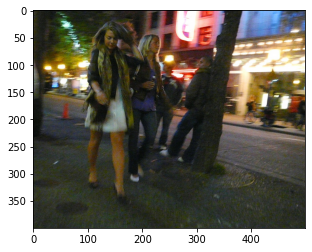

Expert Caption: ['group of women walk down street at night', 'three women out for the evening in big city', 'two girls pass two boys by tree in neon lit street', 'two women walk down city street at night', 'women are walking at night under neon lights']
Blue score 2.2250738585072626e-308
caption: man in red shirt is walking down street with red umbrella in the background


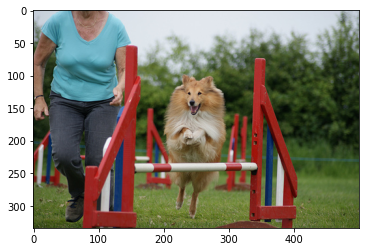

Expert Caption: ['woman in blue shirt guides her dog over an obstacle', 'woman is running beside dog that is jumping over red and white obedience training fence', 'woman next to dog which is running an obstacle course', 'woman walking with sheltie through competition obstacle course', 'the dog is jumping over the hurdles beside woman']
Blue score 0.16666666666666669
caption: dog is running over red and red pole


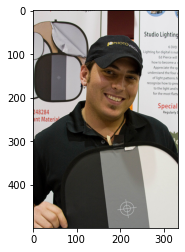

Expert Caption: ['man in black cap and shirt smiling while holding white grey and black rectangular object', 'man smiles and poses with product he appears to be trying to sell', 'man wearing black shirt and baseball cap smiling', 'the man is wearing black shirt and hat and smiling', 'there is man with black shirt and black hat smiling']
Blue score 0.5555555555555556
caption: man in black shirt and black hat is wearing black hat


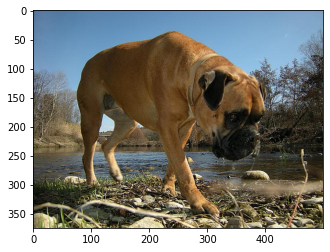

Expert Caption: ['brown dog walks on the rocks near river', 'dog is walking through some gravel beside river', 'dog with snub nose smells for somthing on riverbank', 'large brown dog is walking along side river', 'large tan bulldog walking along the rocky shore of small stream']
Blue score 0.16666666666666669
caption: brown dog is digging hole in the sand


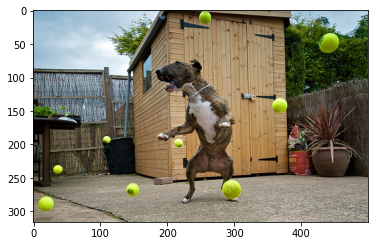

Expert Caption: ['big dog stands on his hand leg as tennis balls are thrown his direction', 'brown and white dog in front of shed overwhelmed by the onslaught of tennis balls', 'brown and white dogs stands in front of wooden building while tennis balls fly through the air', 'dog jumps for several tennis balls thrown at him', 'dog stands on his hind legs amid shower of tennis balls']
Blue score 6.374943338305425e-309
caption: dog jumps over hurdle


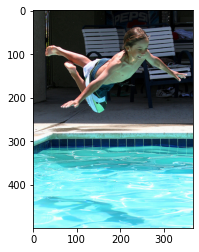

Expert Caption: ['boy is diving through the air into swimming pool', 'boy jumps into pool on bright sunny day', 'boy jumps into the blue pool water', 'smiling child dives into pool', 'the young boy is jumping into the pool on his belly']
Blue score 1.7328892633971685e-308
caption: boy jumping into pool


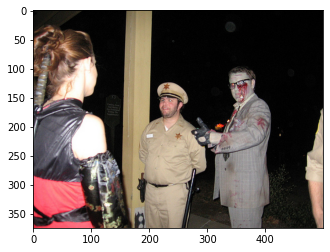

Expert Caption: ['man in uniform costume stands next to man in horro costume', 'man in police costume next to man in zombie costume', 'people are at costume party', 'people at costume party', 'the bloodied man is hit at the haloween party']
Blue score 2.2250738585072626e-308
caption: group of people are standing in front of an event


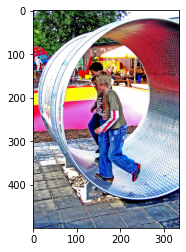

Expert Caption: ['two boys are running in metal barrel', 'two boys are running in spinning tube', 'two boys are walking inside humansize exercisewheel', 'two boys running in giant metal wheel', 'two boys walking to make cylinder roll at small carnival']
Blue score 2.2250738585072626e-308
caption: boy in red shirt is jumping on swing


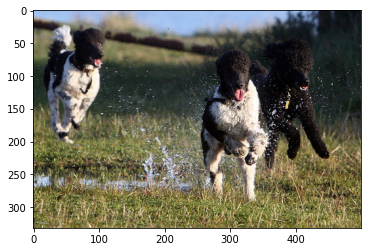

Expert Caption: ['the dogs are running through the water', 'three black and white dogs running through watery field', 'three dogs running through puddle', 'three dogs run through soggy field', 'three dogs run through water and grass']
Blue score 0.25
caption: black dog and brown dog are running through the grass


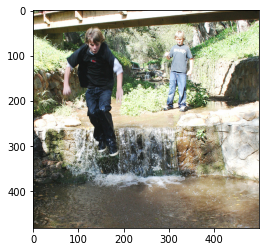

Expert Caption: ['boy jumps into water fully clothed', 'boy jumps into water while another watches', 'boys jumps in the water while another boy looks on', 'kid jumps over small waterful while another boy looks on', 'two boys playing in lake']
Blue score 2.2250738585072626e-308
caption: boy in red shirt is climbing rock wall


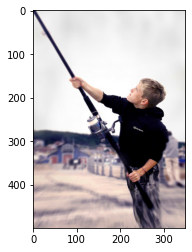

Expert Caption: ['blond boy in dark hoodie is holding fishing rod', 'boy on the beach casts fishing pole in the water', 'little boy is holding fishing rod', 'young boy wearing black hoodie is holding fishing pole', 'young male holding fishing pole']
Blue score 2.2250738585072626e-308
caption: man in blue shirt and white pants is jumping up to catch his head


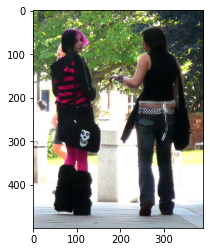

Expert Caption: ['girl with pink streaked hair and fur uggs looks back while the girl walking next to her looks at her', 'two girls facing each other one has skull face bag wearing red and black shirt the other is wearing beaded belt', 'two girls walking down the street', 'two girls wearing goth trendy clothing while one looks back at the camera', 'two young girls wearing goth clothes']
Blue score 0.18400888292586468
caption: woman in red shirt and black pants is walking down the street


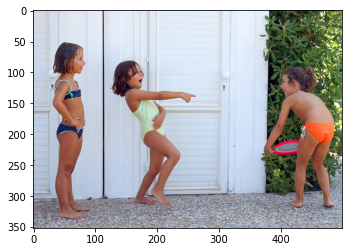

Expert Caption: ['little girls in swimsuits are laughing', 'girl in yellow bathing suit laughs and points at girl in an orange suit while another girls looks on', 'girl in bathing suit pointing and laughing at child in orange bathing bottoms while another girl looks on', 'the girl in yellow is laughing at the girl wearing orange whilst being watched by the girl in blue', 'three children in swimsuites are having fun outside near white building']
Blue score 1.7816998627591863e-308
caption: boy in red shirt is jumping into the air


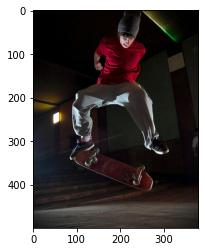

Expert Caption: ['man in red shirt is doing trick with his skateboard', 'man wearing red shirt is skateboarding', 'skateboarder is performing trick in the air', 'skateboarder jumps in the air', 'person doing skateboard trick in midair']
Blue score 0.1278341881163385
caption: man in black shirt and black shirt is skateboarding


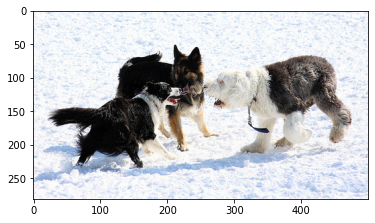

Expert Caption: ['group of dogs look at each other while standing in the snow', 'three dogs come face to face with each other in snowy field', 'three dogs in the snow', 'three dogs meet in the snow', 'three dogs playing in the snow']
Blue score 0.25
caption: two dogs play in the snow


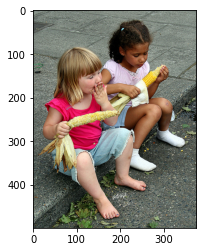

Expert Caption: ['two cute little girls enjoying corn on the cob', 'two girls enjoy corn on the cob while sitting on curb', 'two little girls sitting on the edge of street eating corn on the cob', 'two young girls are sitting on the street eating corn', 'two young girls eating corn on the cob on sidewalk without shoes']
Blue score 0.7354140854871629
caption: two young girls are sitting on the grass


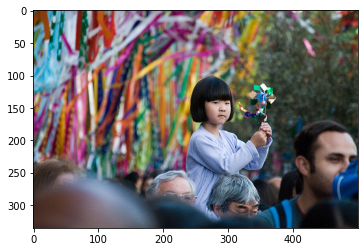

Expert Caption: ['child is holding colorful object and overlooking crowd of people while sitting on the shoulders of an older person', 'girl in blue sweater sits on person shoulders and carries pinwheel', 'girls in blue shirt holds flower while sitting on man shoulders', 'young oriential girl is standing above the crowd playing with pinwheel', 'girl in blue sweater and holding multicolor toy sitting on the shoulders of man with grey hair']
Blue score 1.7816998627591863e-308
caption: group of people are standing in front of tree


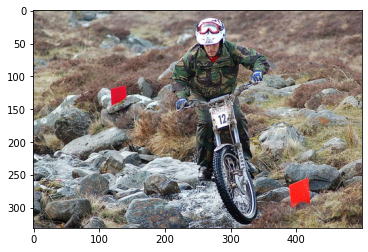

Expert Caption: ['man dressed in camouflage riding motorbike', 'man is going between two red flag markers on dirt bike', 'man is riding dirt bike over some rocks', 'man wearing camouflage steers motorcycle across some stones', 'the man waeribng helmet is riding dirt bike over rocks']
Blue score 0.12500000000000003
caption: man in red helmet is riding bike on dirt path


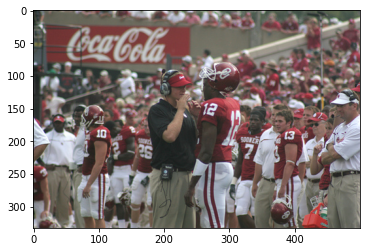

Expert Caption: ['coach speaking to football player while everyone watches', 'football player from ou talks to the coach about the game', 'football player is talking to his coach', 'the coaching official and football player are talking in front crowd and other team members', 'the coach talks it over with his quarterback during timeout']
Blue score 2.2250738585072626e-308
caption: crowd of people in red and white uniforms are standing in front of crowd of people


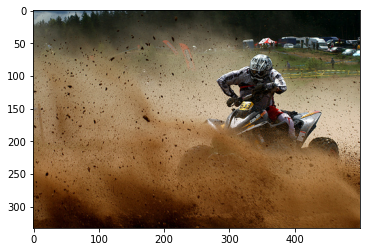

Expert Caption: ['dirt biker aggitates dirt on four wheeler', 'man is riding four wheeler through some dirt', 'person drives an atv through mud', 'person on an allterrain vehicle sending up clouds of dust', 'quad sends dirt flying into the air']
Blue score 2.2250738585072626e-308
caption: two people are riding bicycles on dirt path


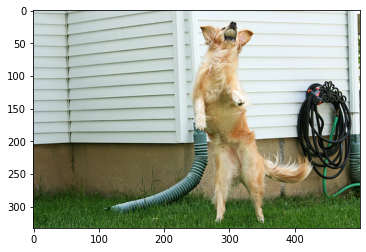

Expert Caption: ['dog catching ball', 'dog jumping up in the air next to white house', 'white dog is standing on its hind legs with ball in its mouth', 'yellow dog stands on his hind legs', 'yellow dog stands on hind legs with ball in mouth building in background']
Blue score 2.2250738585072626e-308
caption: woman is petting little girl on the grass


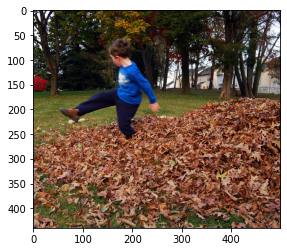

Expert Caption: ['boy kicks through pile of leaves', 'boy with blue shirt kicking off dead leaves from pile of leaves', 'kid in blue top leaps into raked pile of leaves in front of trees', 'little boy in blue is running through pile of brown leaves', 'young boy standing with raised leg in large pile of leaves']
Blue score 2.0133300850710214e-308
caption: little girl in pink dress is walking on the grass


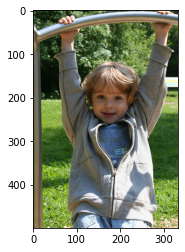

Expert Caption: ['child plays on playground equipment', 'girl is hanging on metal bar in park', 'happy child dangling from playground equipment smiles at the camera', 'little girl in sweatshirt jacket holding on to bar', 'child in grey sweatshirt hanging from metal bar']
Blue score 2.2250738585072626e-308
caption: little boy in blue shirt is sitting on swing


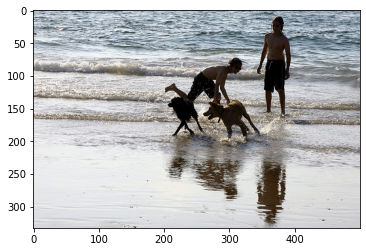

Expert Caption: ['two boys and two dogs are playing in the sand and water at the seashore', 'two boys are playing with two dogs on the beach', 'two boys play with two dogs at the shore', 'two boys play with two dogs next to the ocean', 'two guys are playing with two dogs on the beach']
Blue score 1.3495755153097447e-308
caption: two dogs play in the surf


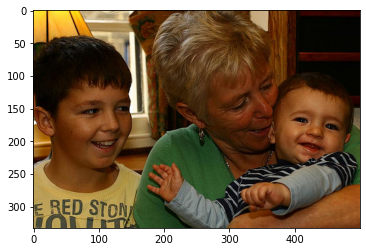

Expert Caption: ['lady holds little boy while another little boy smiles at them', 'an older lady holds toddler while another boy watches', 'white woman in green sweater holds smiling child whilst smiling boy in yellow shirt looks on', 'woman holds baby while boy sits next to her smiling', 'woman holds baby while another child looks on']
Blue score 1.594335087959687e-308
caption: two children are sitting on bed


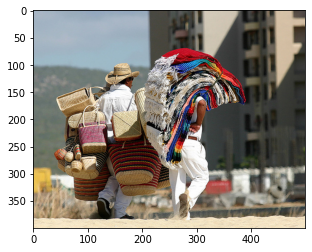

Expert Caption: ['group of people are walking while holding numerous baskets and rugs', 'man carrying many woven baskets next to man carrying stack of rugs on his back', 'two individuals carrying numerous products to sell are walking on beach', 'two people carrying colorful baskets and blankets walk near building', 'two people walking laden down with baskets and blankets']
Blue score 2.2250738585072626e-308
caption: man in red shirt and helmet is riding bike


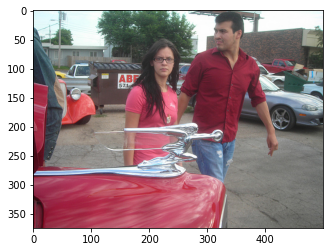

Expert Caption: ['couple in parking lot', 'couple walks past car in parking lot', 'man and woman are walking past car with fancy symbol on the front', 'man and woman walk past red car with silver hood ornament', 'man and woman walking next to red car with an unusual hood ornament']
Blue score 2.2250738585072626e-308
caption: two girls are playing in the street


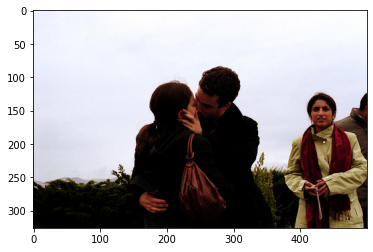

Expert Caption: ['couple kiss outdoors while another couple watch', 'man and woman are outside kissing with woman wearing red scarf in the background', 'the woman on the right is wearing red scarf', 'two people in complete love are kissing in the most beautiful embrace', 'two people kissing']
Blue score 2.2250738585072626e-308
caption: group of people are standing in front of large building


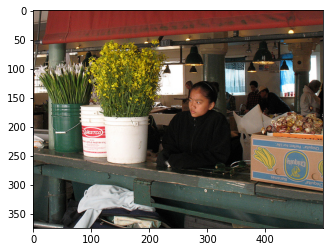

Expert Caption: ['an oriental florist arranging flowers', 'person looking to the right standing between plants in buckets and banana box', 'woman dressed in black standing at green counter with barrels of flowers placed on it', 'woman is standing at counter that is holding buckets of flowers', 'the girl is sitting at the counter between the bucket of flowers and the cardboard boxes']
Blue score 2.2250738585072626e-308
caption: two people are sitting on bench with their hands on the floor


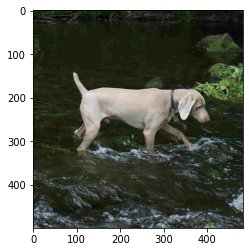

Expert Caption: ['dog is trotting through shallow stream', 'light colored dog is walking through stream', 'male weimaraner with clipped tail is walking through river', 'tan dog walking along in stream', 'the brown dog is walking through river surrounded by bushes']
Blue score 0.545820502051988
caption: dog is walking through water


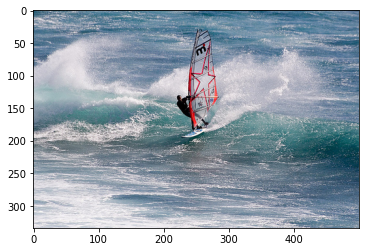

Expert Caption: ['man parasails in the waves', 'man rides large waves on wind sail', 'man windsurfs in the ocean', 'person parasails on the crest of wave', 'windsurfer in the waves of the ocean']
Blue score 0.16666666666666669
caption: man in wetsuit is surfing in the ocean


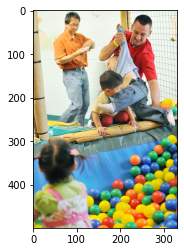

Expert Caption: ['man pulling small child out of ball pit', 'man removes boy from ball pit while two other children and another man watch', 'an adult is pulling child out of ball pit', 'children playing in ball pit', 'two men are watching three children playing in ball pit full of colored balls']
Blue score 1.928867353251809e-308
caption: two children are playing in pit pit


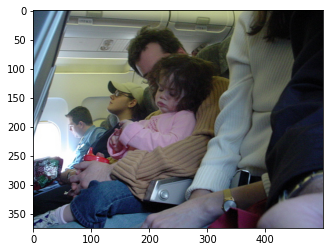

Expert Caption: ['man sits in an airplane seat holding young girl in his arms surrounded by other passengers', 'small girl wearing pink sleeps on man lap as they ride in an airplane', 'young girl falls asleep in her father arms while seated on an airplane', 'little girl sleeping in crowded airplane', 'young girl wearing pink sweater sitting on man']
Blue score 2.2250738585072626e-308
caption: man in black shirt is sitting in chair with man in black shirt


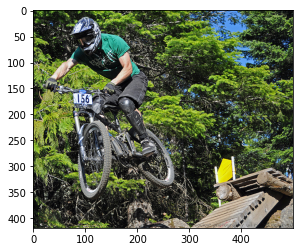

Expert Caption: ['bicyclist wearing helment riding down steep ramp', 'bike rider catches air near ramp', 'bmx rider in midair', 'man wearing green shirt is jumping his bicycle off ramp', 'cyclist in green shirt doing trick on wooden ramp']
Blue score 2.2250738585072626e-308
caption: man on bike is jumping over dirt bike


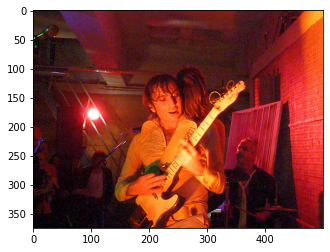

Expert Caption: ['man in fancy clothing plays guitar on stage', 'man playing guitar under the lights with other people in the background', 'woman plays guitar by round light', 'man playing guitar in dark room', 'the man played guitar in the band']
Blue score 2.2250738585072626e-308
caption: man is holding microphone while another man is standing in front of microphone


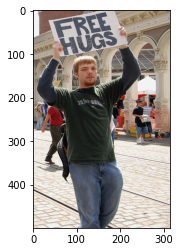

Expert Caption: ['man carrying sign that says free hug along the sidewalk', 'man holds up free hugs sign above his head', 'man is holding sign that says free hugs', 'young man in black shirt is holding free hugs sign', 'the man is wearing green shirt and blue jeans and carrying free hugs sign']
Blue score 0.10000000000000002
caption: man in black and black hat is standing in front of store


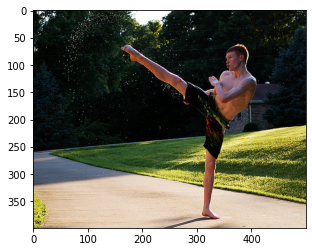

Expert Caption: ['man in black shorts is stretching out his leg', 'man practicing high kick on the cement near the grass', 'young fit man wearing short does high right kick in the air', 'young man practices martial art kicking skill in front of his home in the early morning', 'young man wearing shorts and no shirt is high kicking as water flies from his clothing']
Blue score 2.2250738585072626e-308
caption: boy in red shirt is jumping into the air on the beach


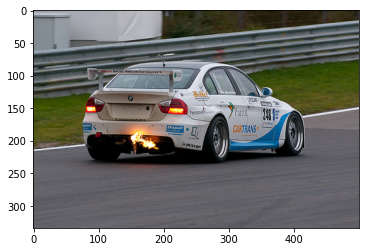

Expert Caption: ['race cars muffler catches on fire', 'race car sparks', 'sports car with flames coming out the exhaust', 'the blue and white race car has flames coming out of its tail pipe', 'the white racing car has fire bursting from its exhaust pipe']
Blue score 2.2250738585072626e-308
caption: race car is driving around track


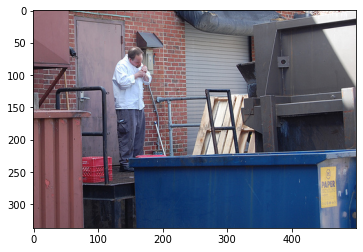

Expert Caption: ['man in white restaraunt shirt smokes next to dumpster', 'man is lighting smoke outside of building', 'man lighting cigarette near dumpster in an ally', 'man lights cigarette on loading dock near dumpster', 'the man is lighting cigarette outside the back of building']
Blue score 2.2250738585072626e-308
caption: man in black shirt and jeans is standing on bench


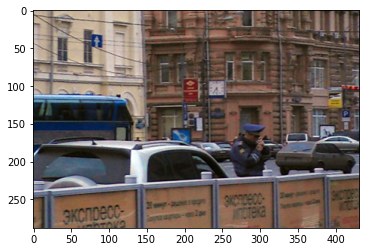

Expert Caption: ['cop stands in front of car on busy street', 'man walks in the city', 'an officer stands next to car on city street', 'policeman stands in front of an suv', 'police officer is lighting cigarette']
Blue score 0.25
caption: two people are sitting in front of an old truck


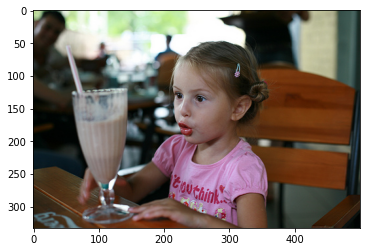

Expert Caption: ['little girl wearing pink shirt is sitting at the table and drinking milkshake', 'small young girl in pink shirt drinking large chocolate milkshake', 'young girl dressed in pink with hair barrette pursing her lips at big chocolate milkshake', 'young girl is staring at large milkshake in glass', 'young girl looks excitedly at large milkshake']
Blue score 2.2250738585072626e-308
caption: young girl with blue shirt is playing with guitar


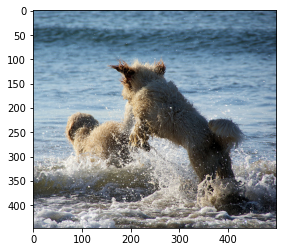

Expert Caption: ['two dogs playing in the water', 'two dogs playing in the water one is bounding at the other', 'two furry beige dogs playing in ocean surf', 'two white dogs are splashing around in white waves', 'two white longhaired dogs playing in the ocean']
Blue score 1.0
caption: two dogs playing in the water


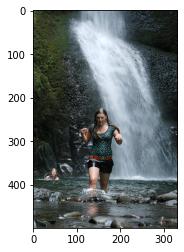

Expert Caption: ['an extremely wet woman is wading in front of waterfall', 'woman dressed in shorts and tshirt walking in shallow water in front of waterfall', 'woman wading through pool in front of waterfall', 'the lady is walking through the water', 'wet woman walking through water near large waterfall']
Blue score 2.2250738585072626e-308
caption: man in red shirt is kayaking on dirt bike


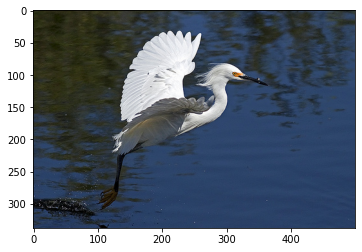

Expert Caption: ['large grey and white water bird', 'large white bird flies over water', 'white birds lands swiftly in the water', 'bird is taking off out of the water', 'large white crane is flying low near the water']
Blue score 0.5
caption: white bird flies over the water


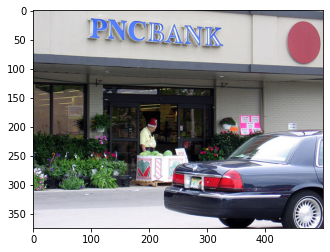

Expert Caption: ['man stands outside bank selling watermelons', 'man with red shriner hat is looking at watermelons in front of bank', 'dark colored mercury car parked in front of pnc bank', 'the man is looking at watermelons for sale outside of bank', 'there is man wearing funny hat standing in front of bank']
Blue score 0.25
caption: man in red shirt is standing in front of building


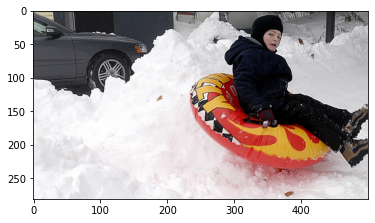

Expert Caption: ['boy in black winter clothes sits on an inflated sled by mound of snow', 'child rides down the snow in tube', 'the kid is on float in the snow', 'there is person sitting on plastic blowup float in the high piled snow', 'this person bundled up for the snow slides down the hill on an intertube']
Blue score 0.2
caption: two children are playing in the snow


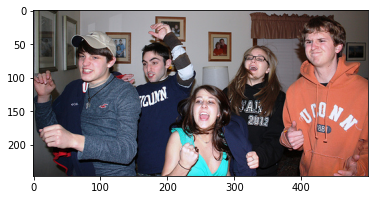

Expert Caption: ['group of people making different expressions', 'five teenagers cheering in living room', 'the room full of youths reacts emotionally as they spectate', 'three boy teenagers and two female teenagers are making excited facial expressions', 'three guys and two girls are watching something and getting excited']
Blue score 0.12500000000000003
caption: group of people are standing in front of an event


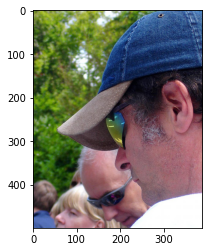

Expert Caption: ['man with baseball cap and shiny sunglasses looks down while another bald man looks down', 'man in denim cap and sunglasses amid crowd', 'man in denim hat wearing dark sunglasses', 'two men in sunglasses look at something in front of them', 'two men wearing sunglasses']
Blue score 2.0133300850710214e-308
caption: woman with mohawk and sunglasses is wearing hat and hat


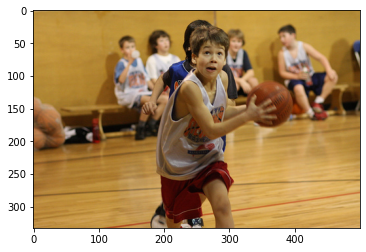

Expert Caption: ['boy with red shorts is holding basketball in basketball court', 'young boy is playing basketball in an official game', 'the boy is playing basketball', 'the boy runs with the basketball while looking up', 'the children are playing basketball indoors']
Blue score 2.2250738585072626e-308
caption: two girls in bathing suits are playing in the air


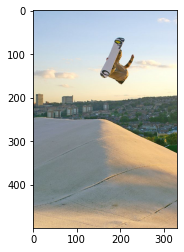

Expert Caption: ['snowboarder is doing flip over mound of snow', 'snowboarder is in midair doing trick', 'somebody in the air on board', 'someone on rooftop jumping on some sort of board caught in midair', 'there is person on snowboard up high in the air']
Blue score 2.2250738585072626e-308
caption: person in black shirt and black helmet is riding bike


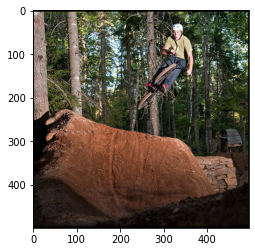

Expert Caption: ['bicyclist flies through the air as he encounters tree in his path', 'bicyclist is jumping over large object', 'man on bike is jumping off dirt ramp', 'man wearing light brown shirt is riding dirt bike in the woods', 'mountain biker is jumping his bike over tree stump in the woods']
Blue score 2.2250738585072626e-308
caption: man is riding bike on dirt path


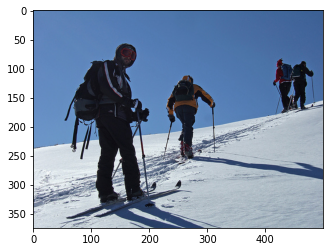

Expert Caption: ['group of skiers going up mountain', 'four crosscountry skiers climb uphill', 'four people climbing hill in the snow', 'four skiers walking up snow covered hill', 'four skiers climbing snow drapped mountain']
Blue score 2.2250738585072626e-308
caption: two people are walking along the beach


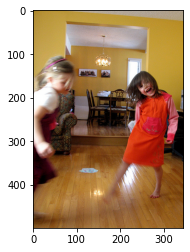

Expert Caption: ['children dancing on hardwood flooring', 'two children are playing or dancing inside', 'two little girls dance on hardwood floor in the house', 'two little girls dancing on the floor', 'two young girls playing in house']
Blue score 2.2250738585072626e-308
caption: woman in red shirt and black shirt is standing in front of an outdoor


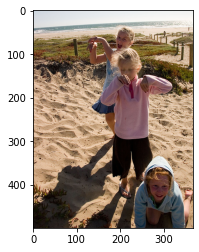

Expert Caption: ['three children are playing in sand near to the beach', 'three children playing in sand at beach', 'three girls play in the sand', 'three little blond girls two in blue one in pink play on sunny beach', 'three young girls dance on the beach in the sand']
Blue score 2.2250738585072626e-308
caption: two young girls are walking along the grass


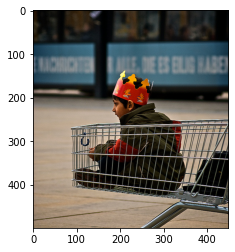

Expert Caption: ['young boy in paper crown is sitting in shopping basket', 'young boy is wearing paper crown while sitting in grocery cart', 'boy with red crown in shopping cart', 'dark haired child wearing jacket and paper crown while sitting in shopping cart', 'kid wearing paper crown sitting in shopping cart']
Blue score 0
caption: two girls are playing soccer on the street


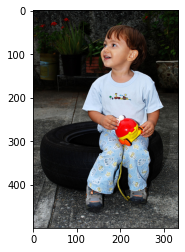

Expert Caption: ['baby sits on tire and holds toy', 'little kid with red toy is sitting on tire', 'boy in pajamas with red and yellow toy seated on tire near plants', 'child holding plastic car sits on tire', 'the child is sitting on the street playing with red toy']
Blue score 0.25
caption: little girl in pink dress is sitting on the sidewalk


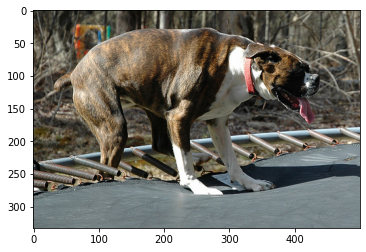

Expert Caption: ['brown and white dog on trampoline with forest in the background', 'brown and white dog with red collar getting on trampoline', 'dog gets on trampoline', 'dog with red collar on trampoline', 'the brown and white dog is standing on trampoline with its tongue hanging out']
Blue score 2.2250738585072626e-308
caption: dog is running through the snow


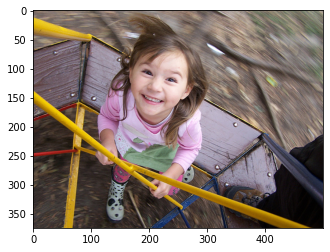

Expert Caption: ['little girl gets her picture taken while on the merrygoround', 'little girl in pink clothes holding yellow rods', 'little girl on piece of playground equipment', 'little girl sitting on playground ride', 'young girl looks up as she rides on merrygoround']
Blue score 2.2250738585072626e-308
caption: child in red shirt is climbing on red slide


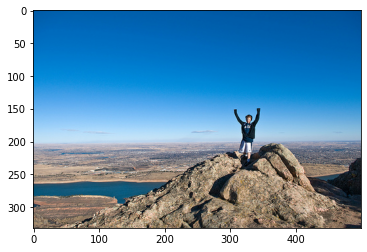

Expert Caption: ['man stands atop mountain with arms extended', 'person on top of mountain with arms over head', 'person stands at the top of mountain and raises his arms', 'man on top of mountain with his arms in the air', 'the man is standing on the rocks above the river with his arms in the air']
Blue score 0.3333333333333333
caption: man is standing on the edge of cliff overlooking the ocean


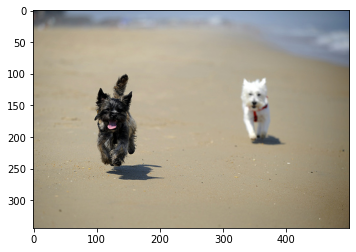

Expert Caption: ['black dog with his pink tongue sticking out running on the beach with white dog wearing red collar', 'white dog is following black dog along the beach', 'two dogs run across the barren ground', 'two dogs running on the beach', 'two terrier dogs frolic on the beach']
Blue score 0.25
caption: black dog runs along the beach


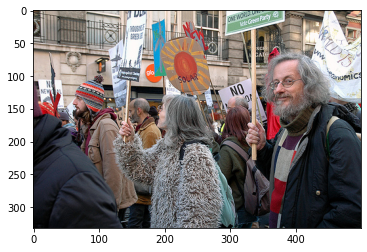

Expert Caption: ['crowd of people wearing jackets and holding signs', 'group of protesters picket in the road', 'large green peaceful protest is taken to the streets', 'protest march is passing by white stone building', 'group of people walking with posters']
Blue score 0.14285714285714285
caption: group of people are standing in front of building


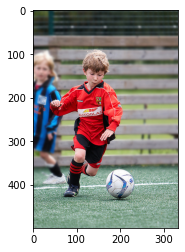

Expert Caption: ['boy soccer player running down the field', 'small boy wearing red runs towards soccer ball', 'young boy dressed in red uniform kicks the soccer ball on the field as another child in blue watches from behind', 'young boy wearing red uniform lines up to kick soccer ball', 'little boy in red getting ready to kick soccer ball while other boy watches']
Blue score 0.11310467725449497
caption: soccer player in red uniform is running towards the ball


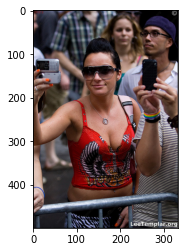

Expert Caption: ['girl in red shirt takes picture on phone', 'woman in low cut shirt takes picture with her cellphone', 'woman in red shirt holding cellphone', 'woman taking pictures with her phone', 'the girl in sunglasses holds up her phone to take picture of something']
Blue score 0.15384615384615385
caption: woman in red shirt and white shirt is standing in front of an outdoor day


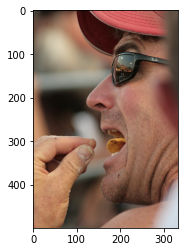

Expert Caption: ['man in red baseball cap eats chip', 'man wearing red hat has potato chip in his mouth', 'man wearing sunglasses and red cap putting chip in his mouth', 'man wearing sunglasses and red hat is opening his mouth wide and eating chip', 'man with sunglasses on puts chip in his mouth']
Blue score 2.2250738585072626e-308
caption: young boy with mohawk eyes and is wearing sunglasses


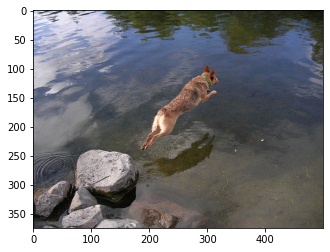

Expert Caption: ['brown dog jumping off rock into lake', 'brown dog leaps into water from rock', 'dog is taking dive into body of water', 'dog leaps over the water from rock', 'the dog is leaping into the water']
Blue score 2.2250738585072626e-308
caption: two dogs are playing in the water


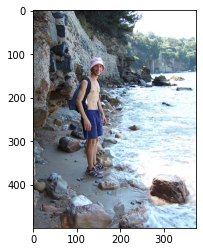

Expert Caption: ['man stands at the edge of the water near the rocks', 'shirtless man in pink hat is standing on rocky shore', 'shirtless man in pink hat stands on rocky shore', 'shirtless man with backpack and hat is standing on rocky shoreline', 'the man in shorts and hat is standing in the bay beside the ocean']
Blue score 1.6720924800836196e-308
caption: two people are walking on the beach


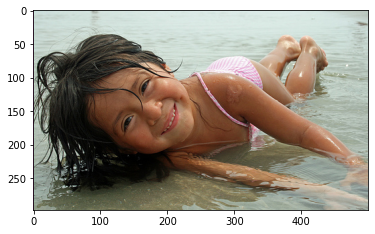

Expert Caption: ['closeup of young child wearing pink bathing suit laying in shallow water at the beach', 'little girl smiles as she lays on her side in the water', 'smiling toddler in pink swimsuit is laying in the water', 'young dark haired girl in pink and white swimsuit smiles as she lies in three inch deep water', 'little girl in swimsuit lies on stomach in water smiles at camera']
Blue score 4.9648108639081e-309
caption: young boy in pool


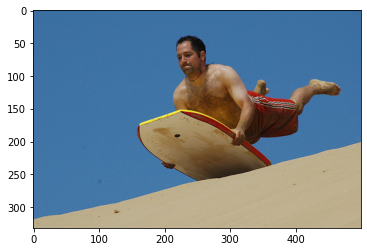

Expert Caption: ['man in red swim trunks is jumping onto bodyboard', 'man in red trunks flies through the air with boogie board', 'man with wakeboard is diving over surface that is not water', 'shirtless man bodysurfs', 'man is diving onto his wakeboard']
Blue score 2.2250738585072626e-308
caption: man in black shirt and black pants is climbing rock


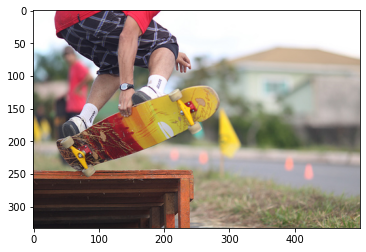

Expert Caption: ['boy skateboarding', 'man jumps off an orange ramp with his skateboard', 'skateboarder ollies off ramp', 'person doing skateboard stunt', 'the man in the background is watching the skateboarder complete jump']
Blue score 0
caption: dog jumping over hurdle


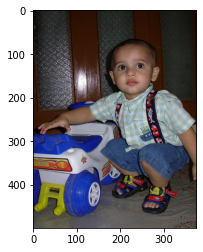

Expert Caption: ['boy plays with car', 'boy playing with truck', 'the baby in suspenders sits by toy', 'the little boy with the big brown eyes is touching the little car', 'the toddler in suspenders plays with truck']
Blue score 2.2250738585072626e-308
caption: baby in blue shirt is sitting on red slide


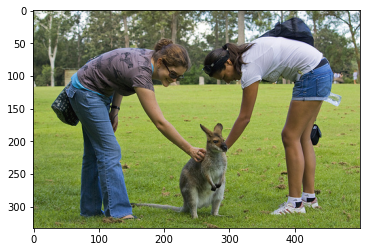

Expert Caption: ['woman in jeans and woman in shorts are petting baby kangaroo', 'two girls pet small kangaroo in grassy field', 'two women bend over to touch small kangaroo', 'two women pet baby kangaroo in the park', 'two women pet kangaroo in park']
Blue score 2.2250738585072626e-308
caption: man is petting dog to catch frisbee


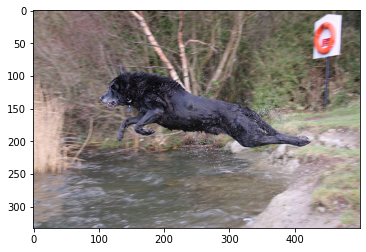

Expert Caption: ['black dog is leaping into creek', 'black dog is leaping over stream of running water', 'black dog jumping off river bank near wooded area', 'wet black dog jumping into lake', 'wet black dog leaps across stream']
Blue score 0.2
caption: black dog is running through the grass


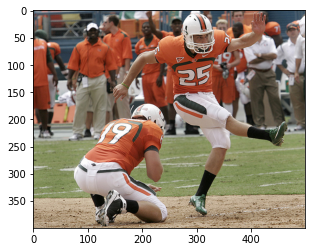

Expert Caption: ['holder and kicker for football team dressed in orange white and black play while onlookers behind them watch', 'kicker launches the football forward while the holder checks his fingers', 'the football player wearing white helmet and orange chairs swing his leg while the player next to him kneels', 'two football player are in the kick off position in front of crowd', 'two young men on the same football team are wearing orange and white uniforms and playing on an outside field while coaches and other players watch']
Blue score 1.5292694074701025e-308
caption: two men in white uniforms are playing soccer


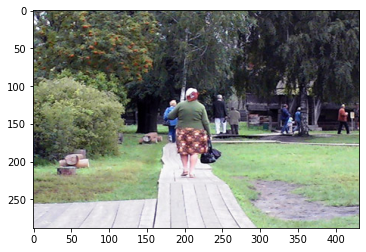

Expert Caption: ['woman in skirt walks down path', 'woman walks on boards', 'woman with scarf on her head walks down wooden boardwalk', 'several people in park walking on low wooden boardwalk', 'the woman wearing the brown skirt is carrying black bag along wooden walkway']
Blue score 2.2250738585072626e-308
caption: little girl in pink dress is walking on the sidewalk


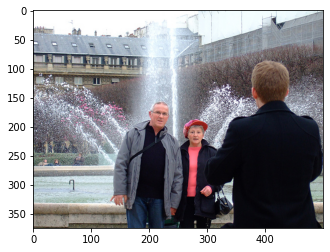

Expert Caption: ['couple is photographed in front of large outdoor fountain', 'couple pose in front of fountain', 'an older couple posing in front of fountain for picture', 'older couple posing for picture in front of fountain', 'the parents of the younger male are posing for picture in front of water fountain']
Blue score 0.14285714285714285
caption: man and woman are standing in front of building


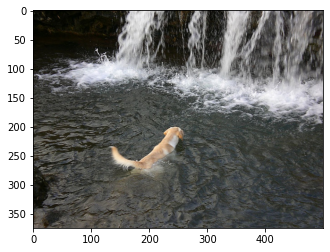

Expert Caption: ['dog swims towards waterfall', 'tan and white dog swimming towards waterfall', 'yellow dog swims towards waterfall', 'the dog swims through the water toward the waterfall', 'the dog swims towards waterfall']
Blue score 1.0
caption: dog swims through the water


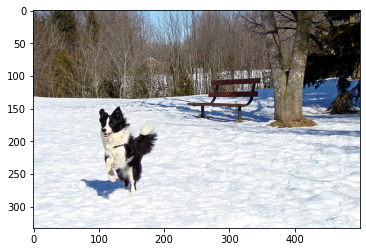

Expert Caption: ['black and white dog is jumping in the snow at park', 'black and white dog running in snowy park', 'black and white dog runs over snow by tree and bench', 'small white and black dog jumping in the snow', 'black and white dog running in the snow']
Blue score 1.221146424717419e-308
caption: dog runs through the snow


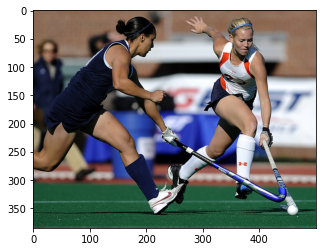

Expert Caption: ['two girls are fighting over ball during game', 'two woman competing in sporting event', 'two women are playing game with sticks and small white ball', 'two women are reaching with sticks for ball during sports game', 'two women playing field hockey']
Blue score 1.7328892633971685e-308
caption: two men playing soccer


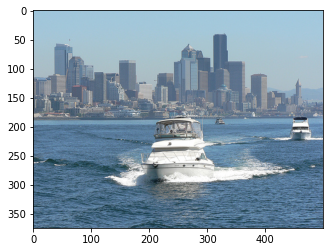

Expert Caption: ['few boats ride in the water in front of city skyline', 'large boat drives through the harbor', 'white boat is cruising near large city backdrop', 'small yachts in harbor city in background', 'there is white boat in the bay with city in the background']
Blue score 2.2250738585072626e-308
caption: people are standing in the middle of the street


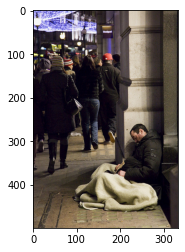

Expert Caption: ['homeless man living on the street', 'man covered with blanket is asleep on the sidewalk', 'man sleeps under blanket on city street', 'man takes nap on the sidewalk in busy city', 'the man is sleeping under blanket in the street as the crowds pass by']
Blue score 2.2250738585072626e-308
caption: man and woman are sitting on bench


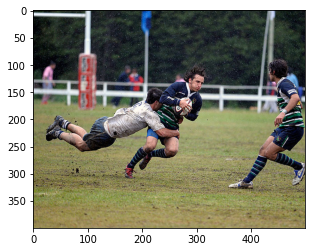

Expert Caption: ['during game of rugby man tackles another', 'men play football', 'the guys are playing sport', 'the man with the soccor ball is being hit by another man', 'three men play ball in field']
Blue score 2.2250738585072626e-308
caption: two men playing soccer


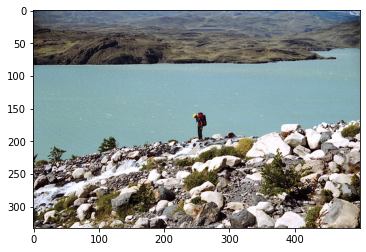

Expert Caption: ['man stands alone on the rocks', 'man stands on rocky cliff overlooking body of water', 'person is standing on jagged rocks above the water below', 'person with backpack stands on rocky bank beside body of water', 'person standing on rocky edge of water with hilly land in background']
Blue score 2.2250738585072626e-308
caption: two people are standing on rocks overlooking the ocean


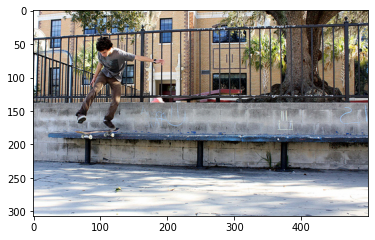

Expert Caption: ['boy on skateboard is making jump from blue bench beside white wall', 'boy skateboarding in an urban area', 'skateboarder midair with his skateboard', 'teen grinding bench on skateboard', 'the boy is skateboarding on the bench by the fence']
Blue score 2.2250738585072626e-308
caption: boy is jumping over bridge


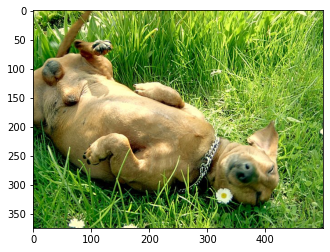

Expert Caption: ['brown puppy is laying on its back in the grass', 'dog lays down in the long green grass', 'dog rolling in the grass', 'dog rolls in the grass', 'golden dog is laying on its back in the grass']
Blue score 0
caption: two dogs are playing with each other


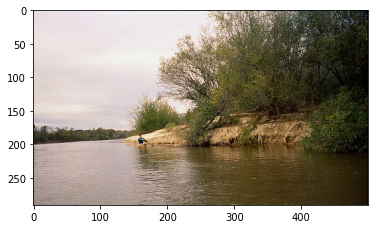

Expert Caption: ['man boating along river near the shore', 'man paddling kayak along the shore of river', 'person is riding in canoe on lake next to green trees', 'person is wading through river near an eroded embankment', 'single person rowing small boat on lake']
Blue score 2.2250738585072626e-308
caption: person is standing on the edge of the water


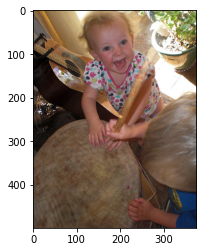

Expert Caption: ['baby girl and little boy are standing next to guitar and drum', 'young laughing girl and boy are playing on big drum', 'two little kids are beating on bongo drum', 'two small children with blonde hair are playing drum one is smiling', 'two young children are playing with drum']
Blue score 2.2250738585072626e-308
caption: little girl is sitting on the floor with his hands on his head


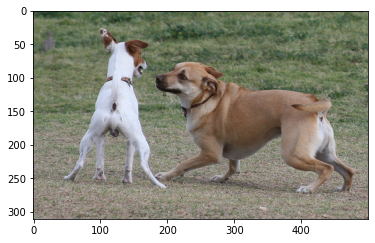

Expert Caption: ['big brown dog chases smaller white dog around in the grass', 'terrier dog and mixed breed dog playing', 'white dog and brown dog fighting', 'the white and brown dog are playing in the dead grass', 'two dogs paying attention to each other']
Blue score 0.11310467725449497
caption: two dogs are playing with each other in the grass


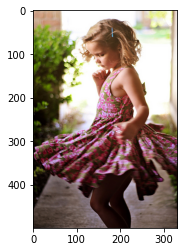

Expert Caption: ['girl twirls in pink dress', 'little girl dancing in pink and green dress', 'little girl twirls around in flowery dress', 'young girl in pink dress is dancing', 'blonde girl in green dress with pink flowers']
Blue score 2.2250738585072626e-308
caption: young boy is riding on swing


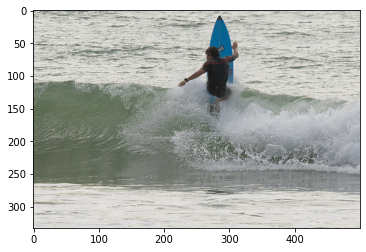

Expert Caption: ['surfer on blue surfboard is falling off of it as he hits wave', 'surfer rides up the wave', 'man falling off blue surfboard in the ocean', 'the surfer is in the wave', 'the surfer rides wave on blue surfboard']
Blue score 0.25
caption: man is kayaking in the ocean


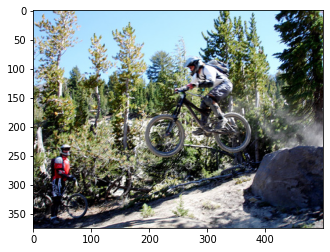

Expert Caption: ['helmeted man jumping off rock on mountain bike', 'man jumping on his bmx with another bmxer watching', 'mountain biker is jumping his bike over rock as another cyclist stands on the trail watching', 'person taking jump off rock on dirt bike', 'the bike rider jumps off rock']
Blue score 2.2250738585072626e-308
caption: man in red helmet is riding bike through the woods


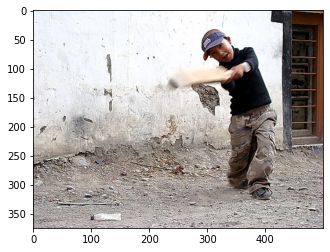

Expert Caption: ['boy in dusty alley playing stickball', 'boy swings piece of wood', 'child swings bat next to stone wall', 'young boy wearing blue visor swings bat', 'young boy with visor on plays ball with his bat in the street']
Blue score 2.0471667756573244e-308
caption: boy in red shirt and white pants is jumping in the air


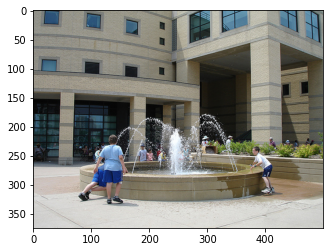

Expert Caption: ['few younger boys play around fountain', 'group of people gather around large fountain', 'three boys play around fountain in an office building courtyard', 'three kids are playing at fountain in front of building', 'three kids playing around fountain']
Blue score 2.2250738585072626e-308
caption: three children play in the water


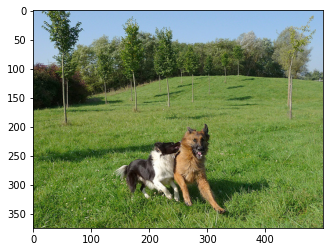

Expert Caption: ['brown dog and black and white dog are running over grassy hills', 'two dogs are running next to each other on grassy hill', 'two dogs in motion in grassy field with small trees', 'two dogs play in field', 'two dogs running through field']
Blue score 0.4
caption: two dogs are running through the grass


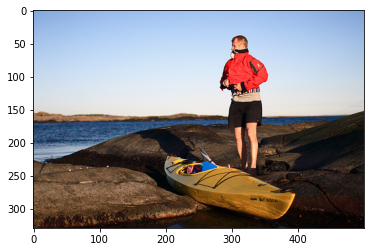

Expert Caption: ['man in red jacket stands near yellow kayak', 'man in red jacket stands next to yellow kayak on rocks by the ocean', 'man pulls on his sweater as kayak lays at his feet', 'man wearing red jacket standing beside yellow canoe on some rocks with water in the background', 'man wearing red jacket stands on the shore of lake with yellow kayak']
Blue score 0.07692307692307693
caption: man in red shirt and jeans is standing on top of cliff overlooking the ocean


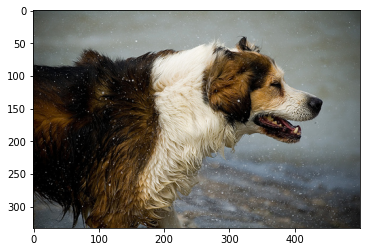

Expert Caption: ['brown and white dog stands outside while it snows', 'dog is looking at something near the water', 'furry dog attempts to dry itself by shaking the water off its coat', 'white and brown dog shaking its self dry', 'the large brown and white dog shakes off water']
Blue score 0.2857142857142857
caption: brown and white dog is swimming in the water


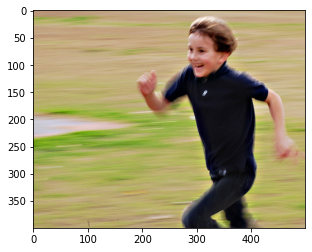

Expert Caption: ['boy in blue shirt runs while smiling', 'child in black shirt running', 'little boy in navy blue is running very fast', 'young boy in dark blue shirt runs as the grassy background blurs', 'young boy in dark clothing with smile sprints']
Blue score 2.031716533983919e-308
caption: young girl in pink bathing suit is running through the water


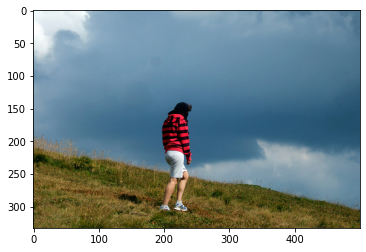

Expert Caption: ['person in red striped hooded sweatshirt and jeans shorts walking on grassy hill', 'person wearing striped shirt is walking on hill', 'woman in striped sweater is standing on hill', 'woman walking across hill with dark clouds in the background', 'one person with pink and black striped shirt and white shorts walking up hill']
Blue score 0.09200444146293235
caption: girl in red shirt and red shirt is walking through the grass


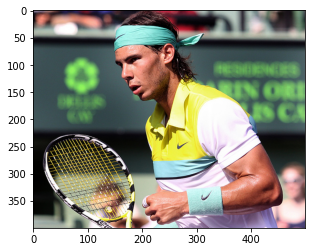

Expert Caption: ['male athlete is wearing teal sweatband and shirt from nike and is holding tennis racket', 'man plays tennis', 'tennis player is carrying tennis racket', 'tennis player wearing yellow white and blue shirt carrying racquet', 'the tennis player is wearing yellow and blue shirt and blue headband']
Blue score 2.2250738585072626e-308
caption: man in white shirt and white shirt is playing tennis


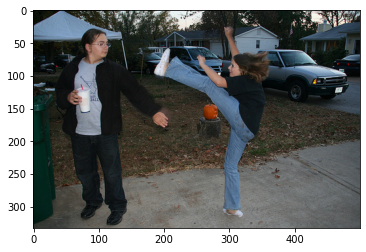

Expert Caption: ['girl doing kick near woman', 'girl in black high kicks over jackolantern', 'girl in jeans tries to show an adult how high she can kick', 'girl kicking her leg up to the shoulder of woman standing next to her', 'woman kicks at man']
Blue score 2.2250738585072626e-308
caption: man and woman sit on bench


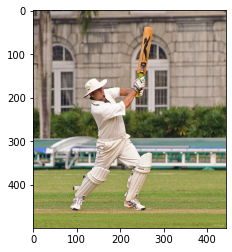

Expert Caption: ['man playing cricket his bat pointed to the sky', 'man dressed in white playing sports', 'the cricketer is swinging bat in the air', 'the man wearing knee protectors swings cricket club', 'the man wearing white clothes and white leg padding is practicing sport']
Blue score 2.031716533983919e-308
caption: baseball player in blue and white uniform is throwing the ball


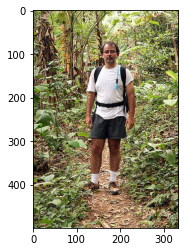

Expert Caption: ['bearded man in white shirt and black shorts is hiking on woodland path', 'man in white shirt is standing on trail in the woods', 'man wearing water pack and shorts on an outdoor trail', 'short stubby man with backpack is standing in forest', 'this man wearing white tshirt and black shorts is standing on path in the forest']
Blue score 2.2250738585072626e-308
caption: man in blue shirt is walking on the grass


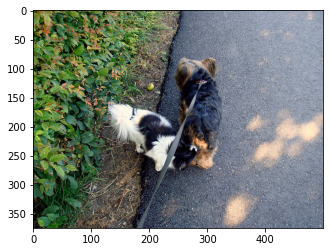

Expert Caption: ['brown and black dog on leash is sniffed by black and white dog', 'dog on leash walks on the sidewalk while another dog follows', 'small dog on leash is being smelled by another animal', 'the black and white dog is sniffing the butt of the brown dog that is on leash', 'two small dogs one blackandwhite and one brownandblack walk down the street']
Blue score 1.4495000173229606e-308
caption: two dogs are playing in the grass


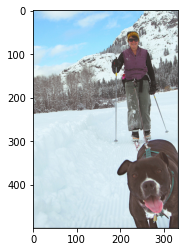

Expert Caption: ['person is skijoring with dog in the mountains', 'person skis with their dog', 'woman crosscountry skiing with brown dog', 'woman skiing down snowy mountain with brown dog on lesh running with her', 'the brown dog pulls skier across snowcovered ground']
Blue score 2.2250738585072626e-308
caption: dog is running through the snow


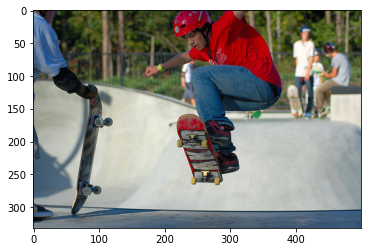

Expert Caption: ['man wearing red helmet jumps up while riding skateboard', 'young man wearing red jacket performs jump on red skateboard', 'the helmeted boy is doing stunt on skateboard', 'the young man is skateboarding at skate park', 'young man is performing trick on skateboard in park']
Blue score 2.2250738585072626e-308
caption: man wearing helmet is riding bike on the street


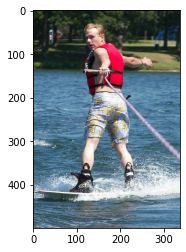

Expert Caption: ['man in swim trunks and red life vest jet skiing', 'man waterskiing with one hand', 'man wearing red life jacked is holding purple rope while waterskiing', 'man wearing swimming trunks is waterskiing backwards using only one hand', 'person in red ski jacket skiing backwards']
Blue score 2.2250738585072626e-308
caption: man in red shorts and red shorts is running on the beach


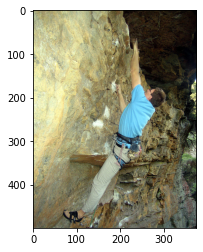

Expert Caption: ['man in blue rock climbing', 'man wearing glasses is rock climbing', 'middle aged woman climbs mountain', 'an adult wearing harness climbs in rocky area', 'person in blue shirt scales wall']
Blue score 1.7328892633971685e-308
caption: man climbing rock face


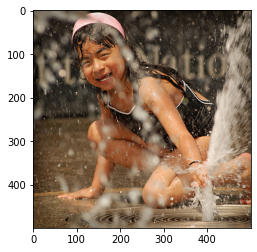

Expert Caption: ['girl with black swimsuit plays in the sprinkler', 'young girl is playing in fountain of water', 'young girl plays in fountain water', 'little girl crouches to splash fountain water', 'there is young girl in bathing suit playing with water shooting out of the ground']
Blue score 2.2250738585072626e-308
caption: the girl is swimming in the water


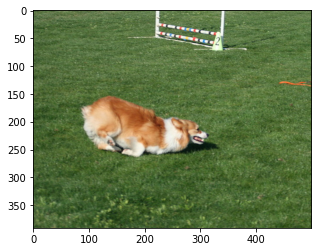

Expert Caption: ['brown and white dog lays down in grassy field', 'dog is crouching on the grass near hurdle', 'dog races along the grassy track', 'tan and white dog is competing in an agility test', 'brown and white dog playing in the grass']
Blue score 2.2250738585072626e-308
caption: dog jumps over red and white ball


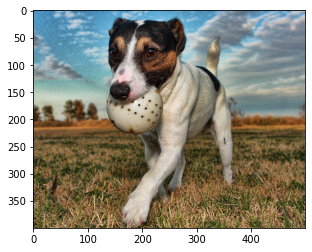

Expert Caption: ['closeup photo of small dog with holey ball in his mouth', 'dog carrying white ball', 'dog fetches ball in field', 'dog trots with ball in its mouth', 'the dog is carrying whiffle ball outside']
Blue score 2.2250738585072626e-308
caption: dog with mouth open is running in the sand


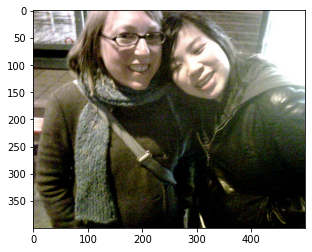

Expert Caption: ['smiling girl in glasses and bluegray scarf with smiling girl in black coat leaning on her shoulder', 'woman leaning her head on the shoulder of another woman', 'two girls one wearing glasses dressed in cold weather clothing smile for the camera', 'two warmly dress girls posing for picture outdoors', 'two young woman hug and pose together for picture']
Blue score 2.2250738585072626e-308
caption: woman with glasses is smiling at the camera


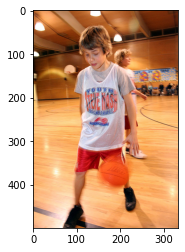

Expert Caption: ['boy dribbles basketball in the gymnasium', 'boy dribbling basketball in gym', 'boy wearing steve nash shirt dribbles basketball on an indoor court', 'child in gray tshirt is bouncing basketball on basketball court', 'one little boy dribbles his basketball']
Blue score 2.2250738585072626e-308
caption: little girl in pink dress is standing in front of house


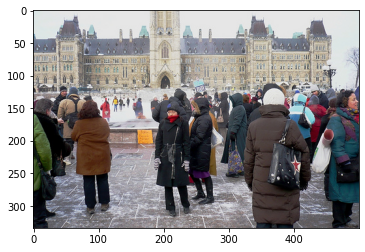

Expert Caption: ['crowd of people in wintergear is standing in front of large royal structure', 'group of people gather in front of historic building', 'many bundled up people are standing in public square', 'there is group of people in winter coats are gather in front of large building', 'tourists are gathering in front of historic building in winter']
Blue score 0.7142857142857143
caption: group of people are standing in front of building


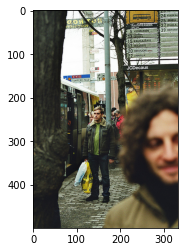

Expert Caption: ['man is standing on sidewalk in the background with blurry image of another man in the foreground', 'man stands at busy bus stop', 'man stands next to bus', 'people in the city', 'people walking down the street and past an open bus']
Blue score 2.2250738585072626e-308
caption: man in black shirt is standing in front of building


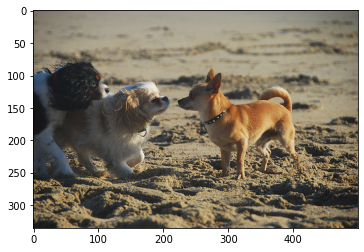

Expert Caption: ['the three dogs are standing in the sand', 'three small dogs stand in the sand and stare at each other', 'three small dogs two of which are sniffing noses', 'two dogs meet and check out third dog at the beach', 'two small dogs facing third dog']
Blue score 0.2
caption: two dogs are playing in the sand


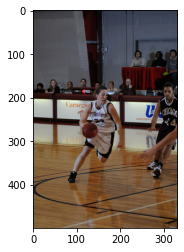

Expert Caption: ['basketball player wearing black and white uniform dribbles the ball', 'at women basketball game white skinned woman dribbles against the chicago defense', 'basketball players in action', 'the basketball player in white is dribbling the ball towards the player in black', 'woman in white dribbling basketball']
Blue score 2.2250738585072626e-308
caption: two men playing softball on the court


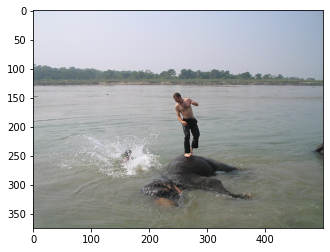

Expert Caption: ['man is standing on an animal in the water', 'man is standing on an elephant lying in some water', 'man standing on rock in river with spash next to him', 'man stands on top of an elephant in the water', 'man stands on top of submerged elephant']
Blue score 0.2
caption: two people are swimming in the water


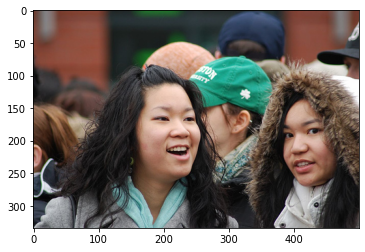

Expert Caption: ['girl with dark brown hair and eyes in blue scarf is standing next to girl in fur edged coat', 'an asian boy and an asian girl are smiling in crowd of people', 'the girls were in the crowd', 'two dark haired girls are in crowd', 'two girls are looking past each other in different directions while standing in crowd']
Blue score 2.2250738585072626e-308
caption: two girls in pink dresses are smiling


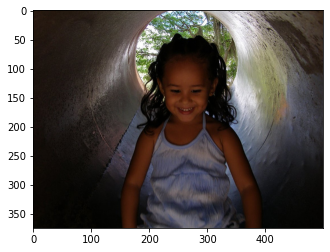

Expert Caption: ['girl wearing blue dress is sliding down tube slide', 'little girl in white top is inside concrete tube', 'little girl is sliding down tunnel smiling', 'little girl smiles as she slides down tube on sunny day', 'young girl in inside tunnel']
Blue score 0.0909090909090909
caption: little girl in pink shirt is standing in front of an orange slide


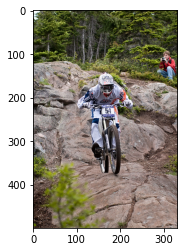

Expert Caption: ['dirt bike rider rides across the rock', 'dirt bike rider takes an unconventional trail in rocky area', 'motocross bike is being ridden over rocks', 'motorcycle rider on path of rocks with person holding camera in the background with trees all around', 'rider on motorcycle riding over rocks']
Blue score 1.991083571408152e-308
caption: man on dirt bike is riding on dirt path


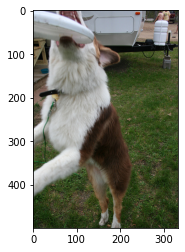

Expert Caption: ['brown and white dog with frisbee in his mouth', 'dog with his front paws off the ground holds white frisbee in his mouth in an rv campground', 'white and brown dog jumps up for white frisbee', 'dog catching frisbee', 'the brown and white dog is catching frisbee in his mouth']
Blue score 0.4412484512922977
caption: brown and white dog is jumping over hurdle


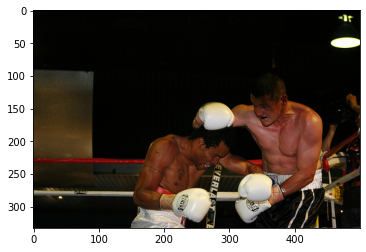

Expert Caption: ['the taller man is trying to block the shorter man', 'two boxers fiercely attacking each other', 'two boxers with white gloves are fighting', 'two men wearing white boxing gloves are in ring', 'two men with white gloves box in dimly lit boxing rink']
Blue score 2.2250738585072626e-308
caption: man in white shirt and white shirt is playing guitar


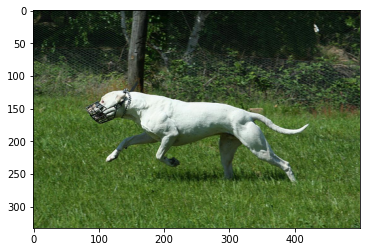

Expert Caption: ['muzzled white dog is running on the grass', 'white dog with muzzle is running on the grass', 'white dog with muzzle is running through an uncut field with fence nearby', 'white dog with muzzle trots on grass in front of trees', 'white dog with muzzle running in the grass']
Blue score 0.25
caption: white dog with brown spots is running through the grass


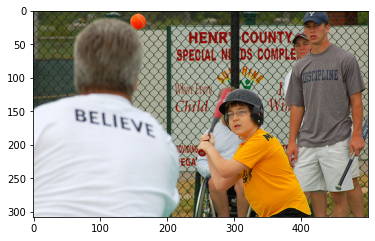

Expert Caption: ['child in an orange shirt holding baseball bat watches the ball thrown at him', 'little league game in action', 'young boy is getting ready to hit baseball', 'young man wearing yellow shirt and baseball helemt swinging bat', 'boy in yellow shirt getting ready to hit orange ball with baseball bat']
Blue score 2.2250738585072626e-308
caption: three young men are standing in front of an outdoor day


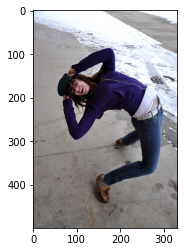

Expert Caption: ['girl in purple sweatshirt bends over backwards', 'girl bending backwards holding her hat', 'person bending backwards', 'person in blue sweatshirt is doing back bend', 'woman in blue bends over backwards on the street']
Blue score 2.2250738585072626e-308
caption: young boy is riding on red swing


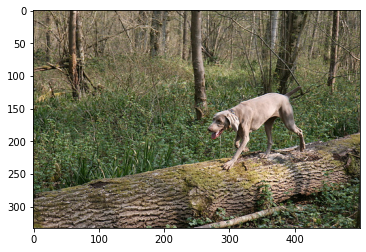

Expert Caption: ['big hound dog walking on log in the woods', 'brown dog walks on top of felled tree trunk', 'grey dog walks on top of fallen tree in the woods', 'skinny brown dog walks across large piece of fallen tree', 'the skinny brown dog is walking on fallen tree']
Blue score 1.6720924800836196e-308
caption: white dog is running through the woods


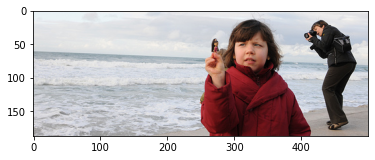

Expert Caption: ['child on the beach while woman takes pictures nearby', 'little girl in red at the beach while adult points camera', 'man and girl are at the shoreline while the man takes picture and the girl hods doll', 'woman is taking photograph on beach at the edge of the water while girl stands in the foreground', 'woman taking pictures of the surf and child in the foreground']
Blue score 0.10000000000000002
caption: woman in red coat and black pants is standing on the beach


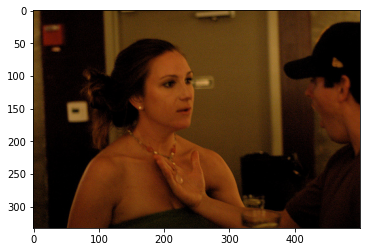

Expert Caption: ['man checks out the beautiful necklace woman is wearing', 'man stands across from woman and holds her necklace while she looks at him', 'man with shocked expression on his face is holding beaded necklace that is around woman neck', 'the man in the black hat holds the brown hair woman necklace', 'there is man looking girls necklace']
Blue score 2.031716533983919e-308
caption: man with glasses is sitting in front of an art gallery


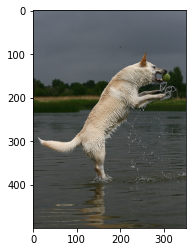

Expert Caption: ['white dog catches green ball while standing in shallow water', 'white dog is jumping up out of the water to catch ball', 'white dog jumps in the water to catch tennis ball', 'white dog jumps out of the water to catch ball', 'white dog jumps out of the water to catch tennis ball']
Blue score 8.18558927632837e-309
caption: dog runs across the water


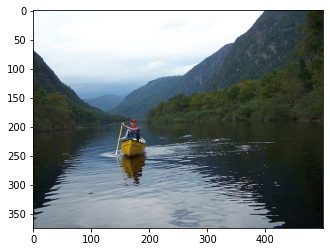

Expert Caption: ['guy rowing yellow canoe down river', 'lone yellow canoe being paddled through river', 'man on scenic canoe trip', 'man with an orange hat in yellow canoe paddles along river in wooded mountainous area', 'man paddling yellow canoe on river']
Blue score 2.2250738585072626e-308
caption: two people are standing on rocks overlooking the water


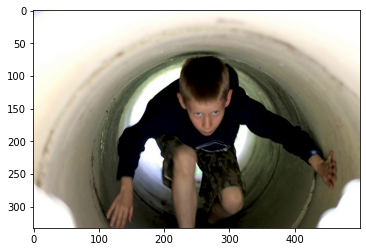

Expert Caption: ['boy crawling through cement pipeline', 'boy in tube', 'young boy dressed in black hoodie crawling through large white tube', 'young boy is crawling through white tube', 'boy crawling through cement tunnel']
Blue score 2.2250738585072626e-308
caption: young boy with his hair on to his face is eating


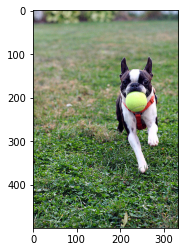

Expert Caption: ['dog is running with yellow tennis ball and wearing red harness', 'small black and white dog running through the grass with tennis ball in his mouth', 'small black and white dog wearing red harness is running around with ball in its mouth', 'small dog with red harness fetching ball', 'the dog wearing the red collar is running across the grass with ball in its mouth']
Blue score 0.14285714285714285
caption: dog with blue collar is running on the grass


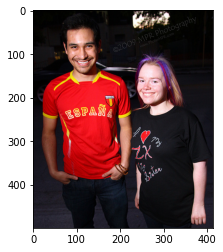

Expert Caption: ['man in red shirt standing next to woman in black shirt with car in the background', 'man in red shirt that says espana and girl with purple streaks in her hair are smiling', 'man with red spain shirt and woman with purple streaks in her hair', 'the man and lady pose for picture', 'the man is wearing red shirt while the woman standing with him has purple streaks in her hair']
Blue score 0.25
caption: man in red shirt and red shirt is holding cup


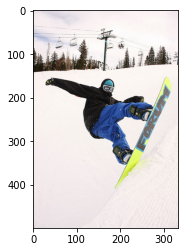

Expert Caption: ['man wearing goggles snowboards on half pipe', 'person on yellow snowboard does some tricks in the snow', 'person snowboarding at ski slope', 'the snowboarder in the blue pants is performing trick', 'the snowboarder is wearing dark top blue pants and helmet with goggles']
Blue score 2.2250738585072626e-308
caption: man in red pants is snowboarding


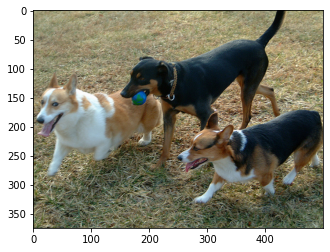

Expert Caption: ['big black dog carries blue ball while two corgis run at his side', 'black doberman brown and white corgi and black brown and white corgi play with blue ball on the grass', 'three dogs one of whom has blue ball', 'three dogs on grass one with blue ball in its mouth', 'three dogs playing with blue ball']
Blue score 2.0133300850710214e-308
caption: two dogs are playing with each other in the grass


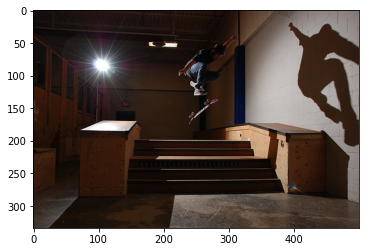

Expert Caption: ['skateboarder casts shadow jumping down stairs', 'skateboarder flies off the stairs', 'skateboarder jumps staircase', 'skateboarder performing kickflip over short stairs', 'skateboarder jumping down short flight of stairs in dimly lit warehouse']
Blue score 2.2250738585072626e-308
caption: skateboarder jumps over railing


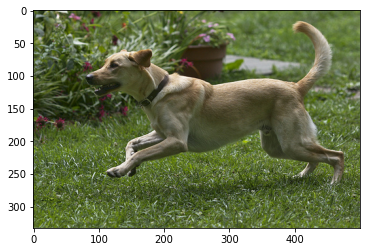

Expert Caption: ['brown dog running', 'brown dog running over grass', 'brown dog with its front paws off the ground on grassy surface near red and purple flowers', 'dog runs across grassy lawn near some flowers', 'yellow dog is playing in grassy area near flowers']
Blue score 1.928867353251809e-308
caption: two dogs are running through the grass


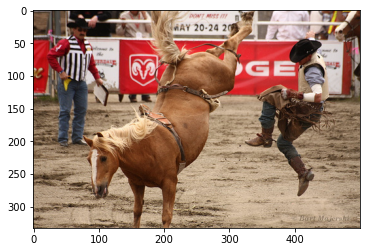

Expert Caption: ['cowboy gets kicked off horse that is bucking', 'cowboy is thrown from the horse he was riding while the judge stands by with his hand on yellow flag', 'man at rodeo is thrown off horse', 'the horse is kicking up its hind legs at the cowboy whist another man stands ad watches', 'two men in western attire with brown horse kicking into the air']
Blue score 2.2250738585072626e-308
caption: man in black shirt and white pants is riding horse


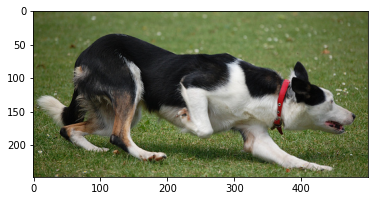

Expert Caption: ['black and white dog is wearing red collar whilst walking on the grass', 'dog is running awkwardly', 'multicolor dog in red collar crouching on the grass', 'black brown and white dog crouches on three legs in the grass', 'the dog with the red collar is white black and brown']
Blue score 2.2250738585072626e-308
caption: two dogs play with ball


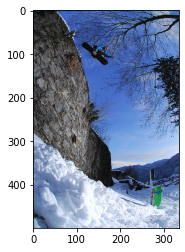

Expert Caption: ['snowboarder going over cliff', 'snowboarder is jumping off high stone wall', 'snowboarder vaulting over rock ridge', 'snowboarder performing trick high in the air over snow', 'the snowboarder is doing jump']
Blue score 2.2250738585072626e-308
caption: man is climbing rock face


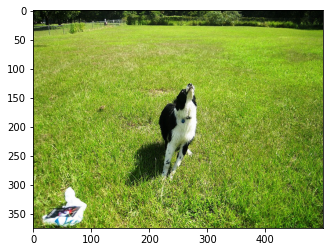

Expert Caption: ['black and white dog looking up', 'black and white dog stares up into the sky on sunny day', 'dog in grassy field looking up', 'dog looking up in grassy field', 'the black and white dog is running on the grass']
Blue score 0.2
caption: brown dog is running through the grass


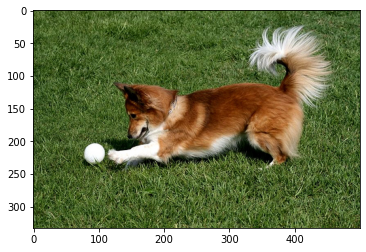

Expert Caption: ['brown and white dog chasing ball on some grass', 'brown and white dog has is playing with white ball on the grass', 'collie plays with white ball in field of green grass', 'orange dog playing with white ball on green grass', 'small brown dog paws at white ball']
Blue score 0.2
caption: brown dog is running on the grass


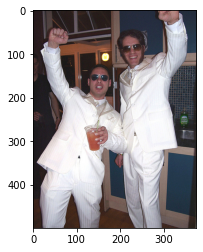

Expert Caption: ['two men dressed in white formal clothes and sunglasses pose while one holds drink', 'two men in white suits and glasses with drink', 'two men in white suits cheer', 'two men wearing white suits and sunglasses are at party punching their hands into the air', 'two young men in sunglasses and white suits raise their arms and smile in bar']
Blue score 0.4
caption: two men in white outfits are dancing


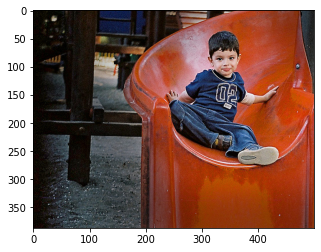

Expert Caption: ['child on red slide', 'little boy sits on slide on the playground', 'little boy slides down bright red corkscrew slide', 'little boy slides down red slide', 'young boy wearing blue outfit sliding down red slide']
Blue score 0.12500000000000003
caption: little girl in red shirt is climbing on red slide


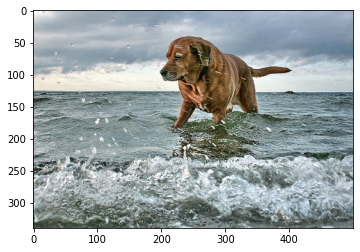

Expert Caption: ['dog standing in the shallow part of the ocean while the waves splash around', 'dog standing in the water', 'wrinkled dog wading in shallow water', 'the large brown dog is walking through water in the ocean', 'the large brown dog stands in the choppy water']
Blue score 2.2250738585072626e-308
caption: dog is running through the water


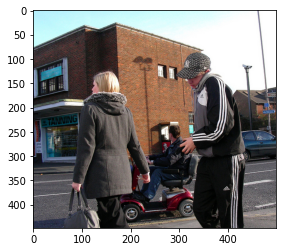

Expert Caption: ['man and woman wait to cross street', 'man talks on his cellphone and another man rides wheelchair', 'woman crosses the street near man who is on his cellphone', 'woman in coat and man in tracksuit talking on phone cross the street', 'woman tries to cross the road before man on red scooter']
Blue score 2.2250738585072626e-308
caption: man in wheelchair is walking past the street


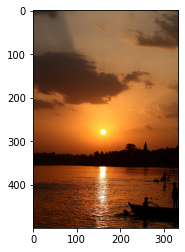

Expert Caption: ['body of water at sunset', 'sunset over lake', 'sunset sky over rippling water', 'water scene with sunset in the background', 'this is beautiful sunset on the water']
Blue score 2.2250738585072626e-308
caption: man stands on the beach


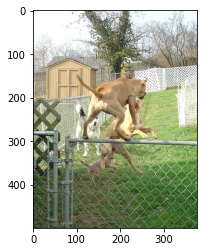

Expert Caption: ['dog jumps over fence while two other dogs watch', 'one dog apparently standing on the edge of fence confronts three others in backyard setting', 'the dog is on the fence', 'three dogs are in fenced yard and one is jumping off the fence', 'two pitbulls fighting one standing on top of fence']
Blue score 0.3032653298563167
caption: dog jumps over hurdle


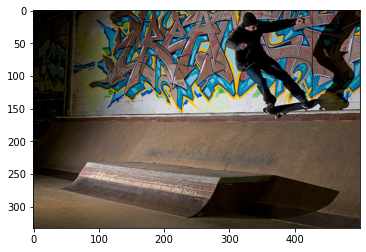

Expert Caption: ['man rides his skateboard with his shadow falling on wall covered in graffiti', 'skateboarder grinding lip', 'skateboarder is jumping through the air in front of graffiti covered wall', 'skateboarder performs skateboard trick against graffiti wall', 'skateboarder performs tricks on ramp in front of wall with graffiti']
Blue score 1.8834843577582417e-308
caption: man on skateboard jumping off ramp


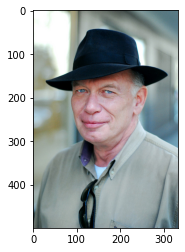

Expert Caption: ['man in black fedora smiles at the camera', 'man in hat posing for picture', 'an older man in weathered fedora smiles slightly for the camera', 'an old man with blue eyes wears big black hat', 'the man is wearing black hat beige shirt and has his sunglasses hanging off the shirt']
Blue score 0.3333333333333333
caption: man in black shirt and black hat is wearing black hat


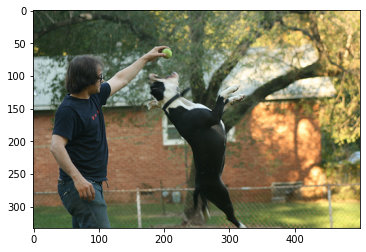

Expert Caption: ['black dog leaps for ball held by man', 'man is playing with black and white dog', 'man wearing glasses and his black and white dog wearing black collar are playing with tennis ball', 'man holding ball while dog jumps up for it', 'man with dog who is jumping to catch tennis ball']
Blue score 2.2250738585072626e-308
caption: man and woman are standing on the grass


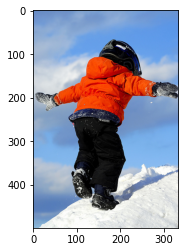

Expert Caption: ['kid walks on snowy hill with their arms out', 'little boy plays in the snow', 'toddler in red jacket is balancing on top of snow', 'young child wearing orange balances on snowy ledge', 'the little boy in black and orange walks through the snow']
Blue score 2.2250738585072626e-308
caption: young boy in red coat and black coat is sliding down snow


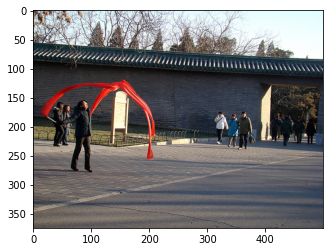

Expert Caption: ['an asian girl performs routine with two red flags in square', 'person waving long red flags', 'woman plays with long red ribbons in an empty square', 'lady waving two long red streamers around', 'two people work with long ribbons in chinese courtyard']
Blue score 0
caption: the boy is jumping into the air


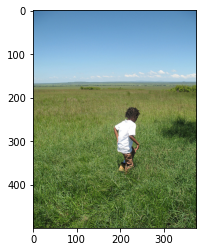

Expert Caption: ['child in white shirt and brown pants is walking through an uncut field', 'child wearing white shirt is walking through the green grass', 'small boy with braids runs through field of tall green grass', 'young child runs through large field of grass', 'the child is walking through tall grass on sunny day']
Blue score 2.2250738585072626e-308
caption: young girl in pink shirt is running through field


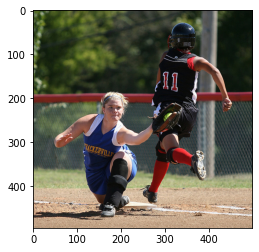

Expert Caption: ['girl in blue and white uniform tags someone in black and red uniform', 'girl is catching baseball before an opponent touches base', 'woman in blue has yellow ball in her mitt', 'girl in blue tries to get base runner number out during softball game', 'two people playing ball on field']
Blue score 0.0909090909090909
caption: baseball player in red and white uniform is trying to hit the ball


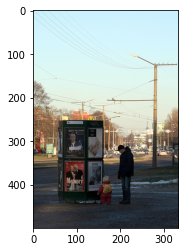

Expert Caption: ['man and toddler look at advertisements', 'man and child in front of billboard', 'man in black coat and hat and child with red snowsuit and pooh backpacker read advertisements near mcdonalds', 'man stands on street corner with small child looking at sign', 'there is man with young child in red outfit looking at advertisements']
Blue score 0.11310467725449497
caption: man in blue shirt is standing in front of building


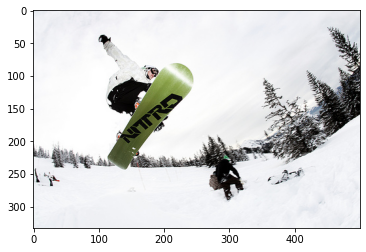

Expert Caption: ['man in white coat jumps snowboard', 'person on green board is snowboarding in midair', 'snowboarder', 'someone on nitro snowboard in midair and another person on the ground behind them', 'two snowboarders in snowy scene']
Blue score 2.2250738585072626e-308
caption: person in red shirt is snowboarding


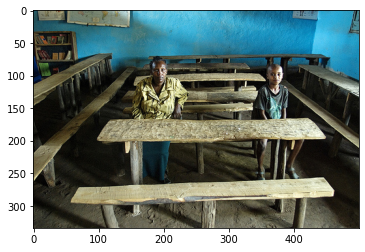

Expert Caption: ['an african man and boy are standing behind coarse wooden table in blue room', 'young boy and an older woman sitting at brown table in blue room', 'the person in the yellow shirt is sitting with child at wooden picnic table', 'two people sit in front of tables in room with blue walls', 'two people sitting in blue room with ratty wooden seats and tables']
Blue score 1.8217363958297824e-308
caption: man in blue shirt is standing on bench with skateboard


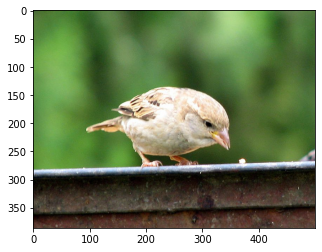

Expert Caption: ['bird eating', 'small pale bird bends down to examine crumb', 'small white bird looks at small object', 'tan bird stands on ledge about to eat something', 'the bird leans over to small piece of food']
Blue score 1.491511611267286e-308
caption: dog is jumping over hurdle


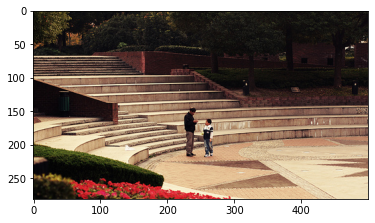

Expert Caption: ['man and child stand at the bottom of an outdoor staircase near benches', 'man and young boy are standing looking at each other in an outdoor garden area', 'man in an ampitheater talking to boy', 'man talks to boy in vacant area', 'the man and the boy are standing at the bottom of the outdoor stairs']
Blue score 0
caption: dog jumping over hurdle


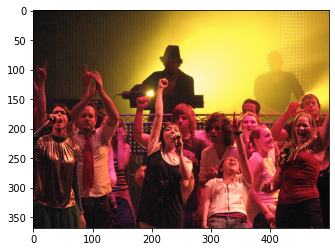

Expert Caption: ['group of people sing and dance at concert', 'group of people singing in front of dj at his station', 'group of performers dancing in front of two djs', 'group of performers sing and work to entertain the audience', 'group of kids singing on stage']
Blue score 0.25
caption: group of people are gathered in front of an audience


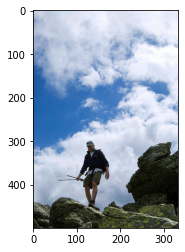

Expert Caption: ['hiker makes his way downhill', 'man carying sticks descends rocky hill', 'man is hiking on mountaintop on cloudy day', 'hiker walking along high rocks in front of blue sky with puffy white clouds', 'the man in blue sweater is climbing down the rocks']
Blue score 2.2250738585072626e-308
caption: man in black shirt and jeans is standing on top of cliff


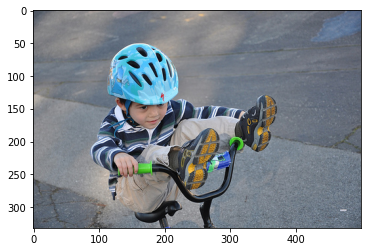

Expert Caption: ['boy wearing blue helmet rides bike with his feet on the handlebars', 'boy with blue helmet plays on his bicycle', 'little boy with blue helmet rides his bike with his feet on the handlebars', 'boy in blue helmet riding bike with feet on handlebars', 'boy with helmet resting his feet on the handlebars of his bike']
Blue score 2.2250738585072626e-308
caption: man in blue shirt is riding bike on the street


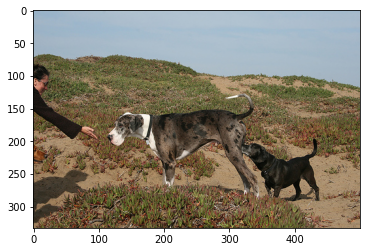

Expert Caption: ['large dog sniffing human hand while small dog is sniffing the large dog butt', 'person reaches for large grey dog while black dog trails', 'smaller dog sniffs larger dog in the hills', 'the black dog is sniffing the brown dog butt', 'the lady ask the dog to give her the ball on their beach walk']
Blue score 1.928867353251809e-308
caption: two dogs are playing in the sand


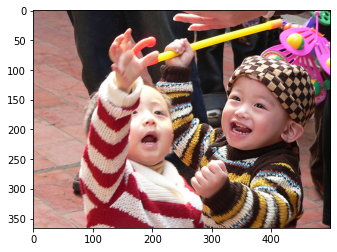

Expert Caption: ['one child reaches up for something while another stands beside him', 'one child with colourful toy and another child reaching up', 'two babies in sweaters playing with toy', 'two children have expressions of happiness as they reach for something out of sight', 'two kids playing on street']
Blue score 2.060331790082205e-308
caption: two girls in red and white are playing with red and white ball


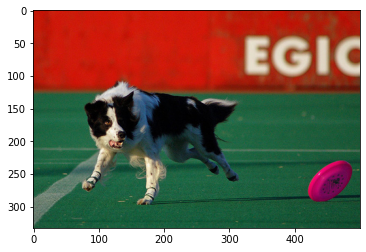

Expert Caption: ['black and white dog chases pink frisbee', 'black and white dog is chasing ping frisbee', 'black and white dog is looking at pink frisbee on court', 'black and white dog is running with pink frisbee next to him', 'dog runs to catch frisbee on astroturf']
Blue score 0.5714285714285714
caption: black and white dog is running through the grass


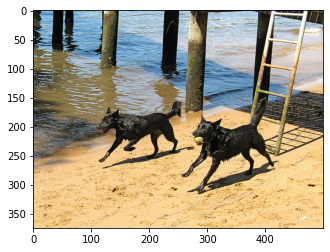

Expert Caption: ['two black dogs each with running on the beach with balls in their mouths', 'two black dogs run in the sand by pier', 'two black dogs run through sand', 'two dogs run across the sand near boardwalk', 'two wet black dogs are running through some sand']
Blue score 0.4
caption: two dogs are running through the water


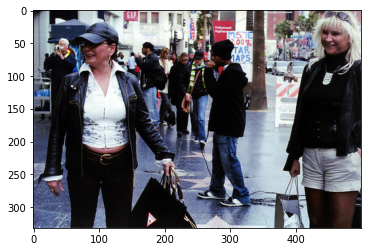

Expert Caption: ['city street with two ladies that have shopping bags in their hands with crowd behind them', 'woman in hat holding handbag smiles away from another woman wearing sunglasses and holding shopping bag', 'people are standing on the hollywood walk of fame', 'two older women walking down the busy street with shopping bags', 'two women dressed in leather are standing on city street']
Blue score 0.14285714285714285
caption: group of people are standing in front of building


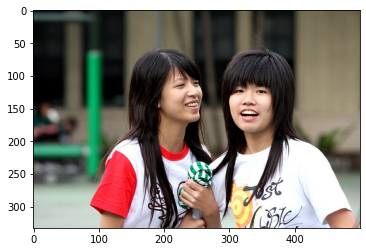

Expert Caption: ['one girl is wearing white tshirt with red sleeves the other has words on hers', 'two asian girls laughing together', 'two girls with dark hair and white shirts', 'two girls with long hair are smiling and one is hold something white and green', 'two women in white shirts talking']
Blue score 2.2250738585072626e-308
caption: two girls in pink dresses are smiling


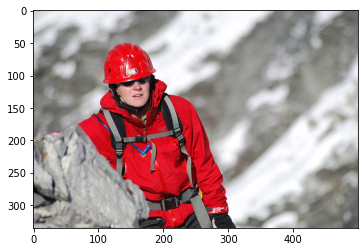

Expert Caption: ['hiker in red on snowy peak', 'person in red jacket and red hardhat stands near mountain', 'person wearing red jacket and helmet walks up near the large rock', 'woman wearing red work man hat and red jacket is hiking in the snow topped mountains', 'the person wearing the red hardhat is on the mountain']
Blue score 0.3
caption: man in red jacket and red hat is walking down snowy hill


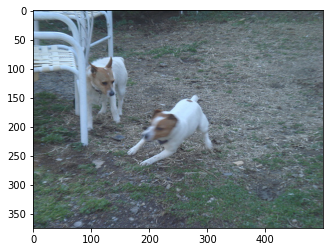

Expert Caption: ['white dog runs past another dog who is standing beside some patio furniture', 'two dogs are outside near patio furniture', 'two small brown and white dogs standing beside some white chairs', 'two small dogs play on the lawn', 'two small white dogs play in the yard']
Blue score 1.8834843577582417e-308
caption: dog is running through the grass


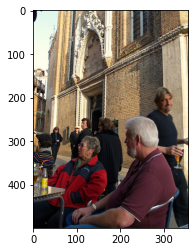

Expert Caption: ['group of people sit at table in front of large building', 'people are drinking and walking in front of brick building', 'people are enjoying drinks at table outside large brick building', 'two people are seated at table with drinks', 'two people are sitting at an outdoor cafe in front of an old building']
Blue score 0.3467511599000727
caption: group of people are sitting on bench


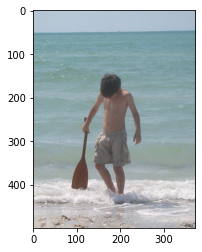

Expert Caption: ['boy holding an oar walk through the ocean', 'boy is carrying paddle whilst walking through the water on beach', 'boy is on the beach with paddle in his hand as he walks through the ocean water', 'boy with an oar walks out of the surf and onto beach', 'little boy walks with paddle out into the sand']
Blue score 0.10000000000000002
caption: man in black shirt and black shorts is walking on the beach


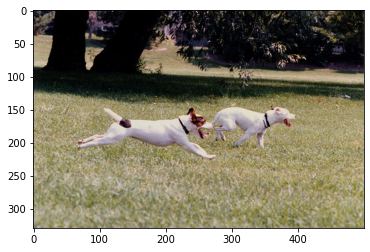

Expert Caption: ['the two white dogs are playing in field', 'two little dogs run in the field', 'two white dogs running', 'two white dogs running in the grass together', 'two white dogs run through the grass']
Blue score 0.2857142857142857
caption: two dogs are playing with ball in the grass


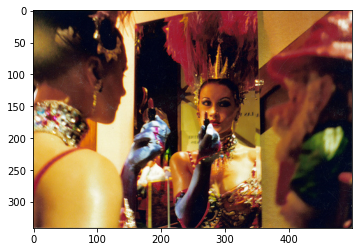

Expert Caption: ['costumes woman applies makeup while looking in mirror', 'showgirl holding lipstick in her hand and wearing feather headdress looks in mirror', 'showgirl puts on her lipstick in the mirror', 'woman in fancy costume is fixer her makeup in front of mirror', 'costumed woman applying lipstick']
Blue score 0.16666666666666669
caption: people are gathered in front of colorful building


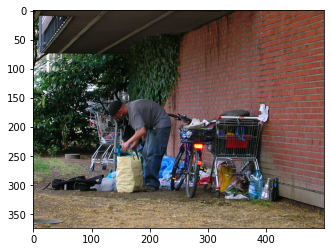

Expert Caption: ['man fiddles with shopping bag outside near shopping cart', 'man gathers his belongings by the side of building', 'man in black cap is opening bag beside bicycle and shopping cart', 'man looks in bag near some grocery carts and bike', 'man outside at red brick building with grocery cart bike and miscellaneous']
Blue score 1.3495755153097447e-308
caption: man and woman sit on bench


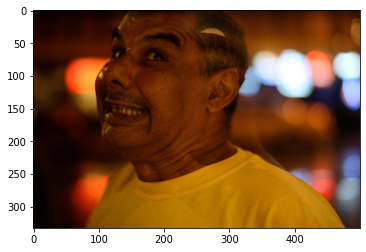

Expert Caption: ['man in yellow grimaces', 'man wearing yellow shirt with dramatic look on his face', 'the man in the yellow tshirt is pulling large grin on his face', 'there is man wearing yellow shirt and grimacing', 'this man is smiling very big at the camera']
Blue score 2.2250738585072626e-308
caption: man in black shirt and sunglasses is smiling


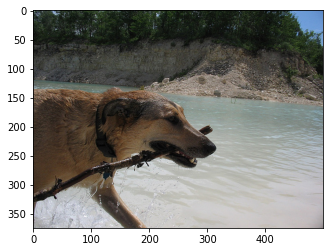

Expert Caption: ['dog carrying stick while walking in water', 'dog with stick in his mouth walking through water', 'large brown dog with stick in his mouth coming out of water', 'wet dog carrying stick in its mouth', 'dog retrieving stick in water']
Blue score 2.2250738585072626e-308
caption: dog is swimming in the water


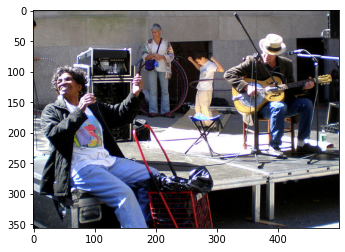

Expert Caption: ['guitarist plays while people play with hulahoops in the background', 'guitarist sits playing before microphones while man and boy dance and woman stands by', 'man in white hat plays guitar on stage', 'man plays guitar on stage while another woman smiles', 'four people performing music outdoors']
Blue score 2.2250738585072626e-308
caption: group of people are standing in front of building with flags


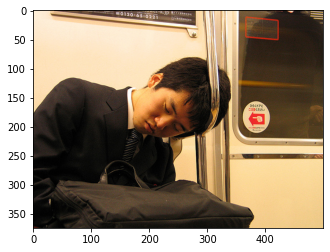

Expert Caption: ['man sleeping with bag on his lap on public transportation', 'man who has fallen asleep on public transportation', 'an asian man in suit on the subway asleep', 'tired business man takes quick nap while riding the train', 'young man in suit and tie leans against railing to take nap on public transit']
Blue score 2.2250738585072626e-308
caption: man in black shirt is sitting in chair


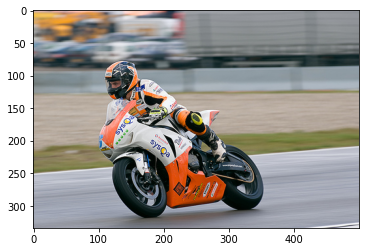

Expert Caption: ['man racing an orange motorcycle', 'man riding an orange and white motorcycle', 'motorcyclist races around track', 'an orange and white motorcycle is being ridden on racetrack', 'someone is driving an orange motorbike along pavement']
Blue score 2.2250738585072626e-308
caption: man on motorcycle is riding on racetrack


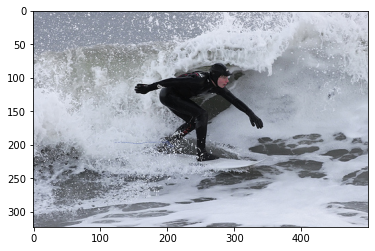

Expert Caption: ['person in black wetsuit is surfing in the ocean with wave coming down', 'person is surfing', 'surfer in all black is riding wave', 'surfer rides the waves', 'woman in black wetsuit surfs in bad weather']
Blue score 0.42857142857142855
caption: man in black wetsuit is surfing on the beach


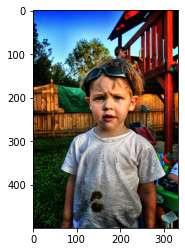

Expert Caption: ['boy wearing sunglasses on his head looks at the camera', 'child with sunglasses and shirt filled with dirt', 'young child with dirty shirt is standing on playground', 'child in dirty white shirt and sunglasses standing in yard', 'little boy who has played in the dirt standing near his swing set']
Blue score 2.2250738585072626e-308
caption: little boy in pink shirt is playing with bubble


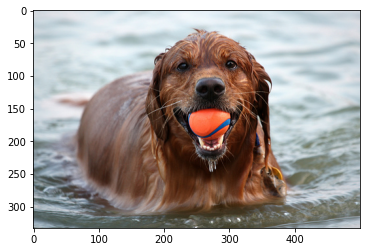

Expert Caption: ['brown dog is swimming through water with an orange ball in its mouth', 'dark brow dog holds an orange ball in his mouth while walking through water', 'dog wading in the water with ball in his mouth', 'wet brownishred dog with an orange ball in his mouth is swimming in some water', 'brown dog in water with orange and blue ball in mouth']
Blue score 0.12262648039048077
caption: dog swims in the water


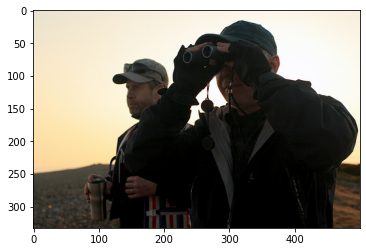

Expert Caption: ['man looks through his binoculars while another man holds drink', 'man with thermos is standing next to man who is gazing through binoculars', 'two men are standing together while one looks through binoculars', 'two men look out as one is holding binoculars', 'two people standing next to each other with mountains in the distance']
Blue score 1.9636207881546135e-308
caption: man stands on the edge of the beach


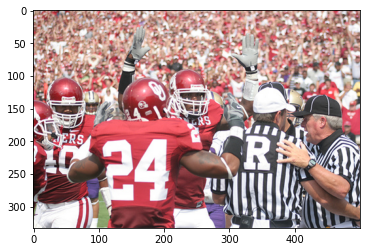

Expert Caption: ['football player in red and white is holding both hands up', 'football players gather around the referees', 'football players gathering to contest something to collaborating officials', 'oklahoma university football players in front of crowd of sooners fans and next to three referees', 'the red and white football team is talking with the officials']
Blue score 0.375
caption: football players in red and white uniforms are playing game


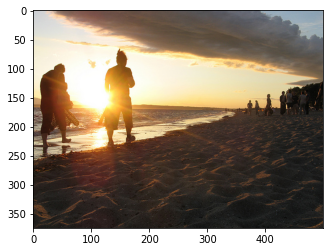

Expert Caption: ['bunch of people on the beach at sunset', 'two people are walking towards group of people on the beach at sunset', 'two people walking along the beach at sunset towarn group of people', 'two people walking along the shore at sunset', 'two people walking on the beach at sunset']
Blue score 2.2250738585072626e-308
caption: man and dog are playing in the water


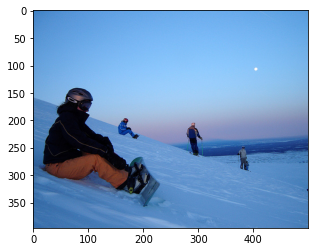

Expert Caption: ['snowboarder sits on slope with skiers and boarders nearby', 'snowboarder takes rest on the mountainside', 'snowboarders sitting in the snow while skiers take the hill', 'the snowboarder is sitting down', 'two skiers stand two sit on slopes']
Blue score 2.2250738585072626e-308
caption: two people are standing on snowy hill


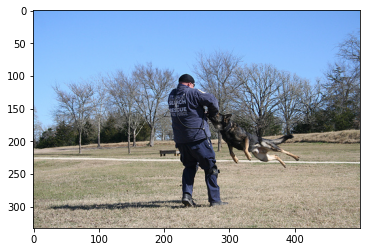

Expert Caption: ['dog is jumping up at man wearing search and rescue jacket', 'large black dog is practicing attacking culprit on uniformed man', 'man in uniform playing with black dog', 'man in blue with black hat with dog leaping at him in parklike setting', 'man in blue padded suit training black dog for search and rescue in field']
Blue score 1.991083571408152e-308
caption: man is walking down the road with his dog


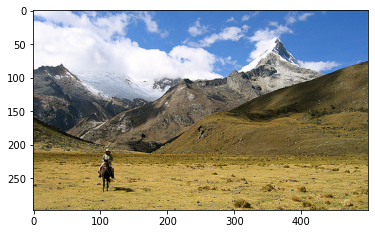

Expert Caption: ['man on horseback on grassy field in front of mountains', 'person on brown horse in prairie in front of tall mountains', 'person riding horse with mountain range in the far background', 'rider on horse in front of mountain range', 'distant horse rider on plain in the middle of brown mountains']
Blue score 2.2250738585072626e-308
caption: man is standing on rock overlooking the mountains


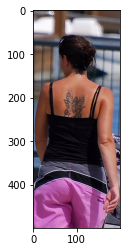

Expert Caption: ['woman dressed in black and pink has large tattoo on her back', 'woman in pink pants and black tank top displays the tattoo on her back', 'woman wearing black tank top revealing large fairy tattoo', 'woman with tattoo on her back walks away from the camera', 'the woman wearing pink pants has tattoo of butterfly on her back']
Blue score 2.2250738585072626e-308
caption: young girl in pink dress is jumping on bed


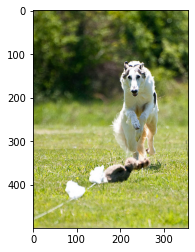

Expert Caption: ['dog chases stuffed animal attached to string', 'white and black dog chases after decoyanimal on string', 'white dog is chasing stuffed animal being pulled on string', 'the white dog is chasing toy that is attached to string across the grass', 'the white dog is running in the green grass']
Blue score 0.4
caption: white dog is running through the grass
Negl count 139
decent count 61
decent average 0.2875941611272022


In [ ]:
bleu_negl = 0
bleu_dec  = 0
bleu_dec_tot = 0
for z in range(200):
  pic = list(encoding_test.keys())[z]
  image = encoding_test[pic].reshape((1,2048))
  x=plt.imread(images+pic)
  plt.imshow(x)
  plt.show()
  img_caption = greedySearch(image)
  bleu_score = get_bleuscore(img_caption,)
  if bleu_score > 0.1:
      bleu_dec +=1
      bleu_dec_tot +=bleu_score
  else :
    bleu_negl +=1pic
  #print("image name",pic)
  print("Blue score",bleu_score)
  print("caption:", img_caption)
print ("Negl count",bleu_negl)
print ("decent count", bleu_dec)
print ("decent average", bleu_dec_tot/bleu_dec)

In [ ]:
for z in range(100):
  pic = list(encoding_test.keys())[z]
  image = encoding_test[pic].reshape((1,2048))
  x=plt.imread(images+pic)
  plt.imshow(x)
  plt.show()
  print("Greedy:",greedySearch(image))